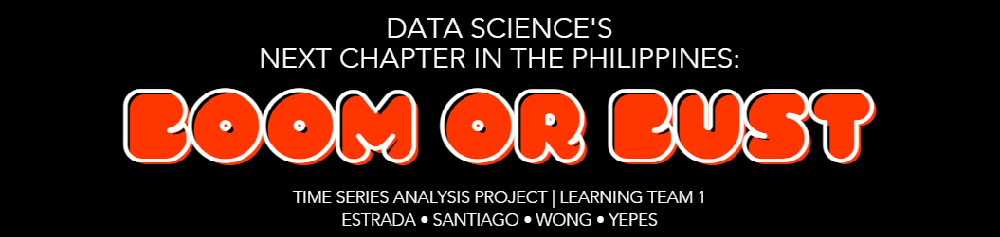

In [2]:
# %%capture
# !pip install hierarchicalforecast
# !pip install -U numba statsforecast datasetsforecast

# !pip install datasetsforecast mlforecast 
# !pip install neuralforecast

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from dateutil.relativedelta import relativedelta

from scipy import stats

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.seasonal import seasonal_decompose

# Base Forecasting
from statsforecast.core import StatsForecast
from statsforecast.models import AutoARIMA, AutoETS, AutoCES, AutoTheta
from statsforecast.models import Naive, SeasonalNaive

# Neural Forecasting
from neuralforecast import NeuralForecast
from neuralforecast.models import NBEATS
from neuralforecast.losses.pytorch import GMM

# ML Forecast
from mlforecast import MLForecast
from window_ops.expanding import expanding_mean
from mlforecast.utils import PredictionIntervals
from mlforecast.target_transforms import Differences
import xgboost as xgb
from sklearn.ensemble import (RandomForestRegressor, AdaBoostRegressor,
                              HistGradientBoostingRegressor)
from sklearn.tree import DecisionTreeRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

# Hierarchical Forecasting
from hierarchicalforecast.utils import aggregate, HierarchicalPlot
from hierarchicalforecast.core import HierarchicalReconciliation
from hierarchicalforecast.methods import BottomUp, TopDown, MiddleOut

# Reconciliation
from hierarchicalforecast.methods import BottomUp, MinTrace
from hierarchicalforecast.core import HierarchicalReconciliation

# Evaluation
from hierarchicalforecast.evaluation import HierarchicalEvaluation
from hierarchicalforecast.evaluation import scaled_crps

# NER
import spacy
from spacy import displacy

In [4]:
def mse(y, y_hat):
    return np.mean((y-y_hat)**2)

def rmse(y, y_hat):
    return np.mean(np.sqrt(np.mean((y-y_hat)**2, axis=1)))

def mase(y, y_hat, y_insample, seasonality=5):
    errors = np.mean(np.abs(y - y_hat), axis=1)
    scale = np.mean(np.abs(y_insample[:, seasonality:] - y_insample[:, :-seasonality]), axis=1)
    return np.mean(errors / scale)

def mae(y, y_hat):
    return np.mean(np.abs(y - y_hat))

def mape(y, y_hat):
    return np.mean(np.abs((y - y_hat) / y)) * 100

# Function to find the best model with the lowest RMSE for each row
def find_best_model(row):
    best_model = row.idxmin()
    best_score = row.min()
    return pd.Series([best_model, best_score], index=['Best Model', 'Score'])

# Function to process and visualize named entities
def visualize_named_entities(text):
    doc = nlp(text)
    displacy.render(doc, style='ent', jupyter=True)
    
def impute_zeros_with_moving_average(Y_df, window_size=4):
    # Make a copy of the DataFrame to avoid modifying the original
    Y_df_copy = Y_df.copy()
    
    # Replace zeros with NaN
    Y_df_copy['y'] = Y_df_copy['y'].replace(0, np.nan)
    
    # Calculate the moving average of non-zero values
    Y_df_copy['y'] = Y_df_copy['y'].fillna(Y_df_copy['y'].rolling(window=window_size, min_periods=1).mean())
    
    # Fill initial NaN values with the first non-zero value
    Y_df_copy['y'] = Y_df_copy['y'].fillna(method='ffill')
    
    # Fill remaining NaN values at the end with the last available non-zero value
    Y_df_copy['y'] = Y_df_copy['y'].fillna(method='bfill')
    
    return Y_df_copy

# Executive Summary

In recent years, the field of data science has evolved beyond being a conventional discipline, emerging as a catalyst for innovation across diverse industries. This escalating interest and widespread adoption of data science globally underscore its transformative potential in reshaping industries, enabling informed decision-making, and addressing intricate challenges. In this context, we delve into the impact of data science within the Philippines. [1]

Our objective is to fully grasp the growth opportunities that data science offers within the Philippine context, particularly in terms of engagement across different hierarchical levels within the Filipino community. To achieve this, we conducted an analysis of posts from Facebook pages relevant to the Philippines, focusing on keywords such as "data science," "machine learning," and "artificial intelligence" from 2021 to the present. Our analysis entailed the utilization of hierarchical forecasting using both statistical and machine learning models, coupled with various reconciliation strategies. The aim was to forecast the trajectory of data science engagement across distinct levels within our hierarchical structure.

The outcome of our analysis indicated that the AutoARIMA model, combined with a Bottom-Up reconciliation strategy, yielded the most promising results. Employing these methods, we were able to craft compelling narratives based on the data. One particularly noteworthy insight pertains to the Education and Learning cluster, where we observed a discernible increase in interest and engagement. This signals substantial potential for nurturing data science initiatives and fostering organic growth within this sector. Furthermore, we identified an opportunity to promote data science in the Entertainment cluster, where engagement levels were comparatively lower.

For the enhancement of our study, we recommend expanding our scope by incorporating additional social media platforms and exploring diverse hierarchical structures. Such an expansion would facilitate a more comprehensive understanding of community engagement and provide fresh analytical perspectives.

Drawing from the insights gained through this project, we advocate for businesses to seize potential startup opportunities aimed at addressing unmet needs within the education sector. Lastly, we propose that data scientists align their work with the values and interests of the target communities. By doing so, engagement levels can be optimized, ensuring that their efforts resonate effectively within these multifaceted contexts.

# Problem Statement

How can we grasp the evolving appeal of data science in the Philippines for informed growth and promotion strategies in the next quarter?

# Motivation

Our study endeavors to address the pressing question of how to comprehensively understand the evolving appeal of data science in the Philippines, with a clear objective of informing strategic growth and promotion strategies for the upcoming quarter.

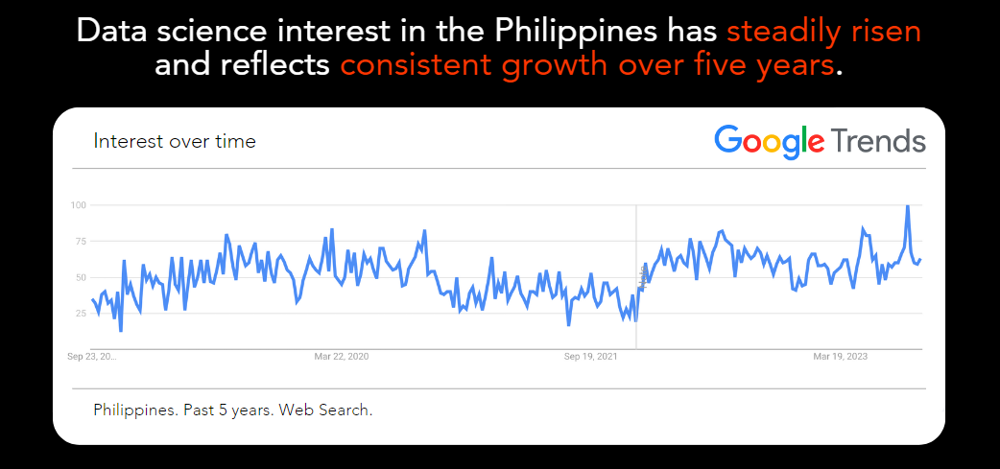

Through this endeavor, we aspire to facilitate a seamless alignment between the aspirations of the Filipino community and the dynamic realm of data science, ultimately unlocking strategic opportunities for sustainable growth and development.

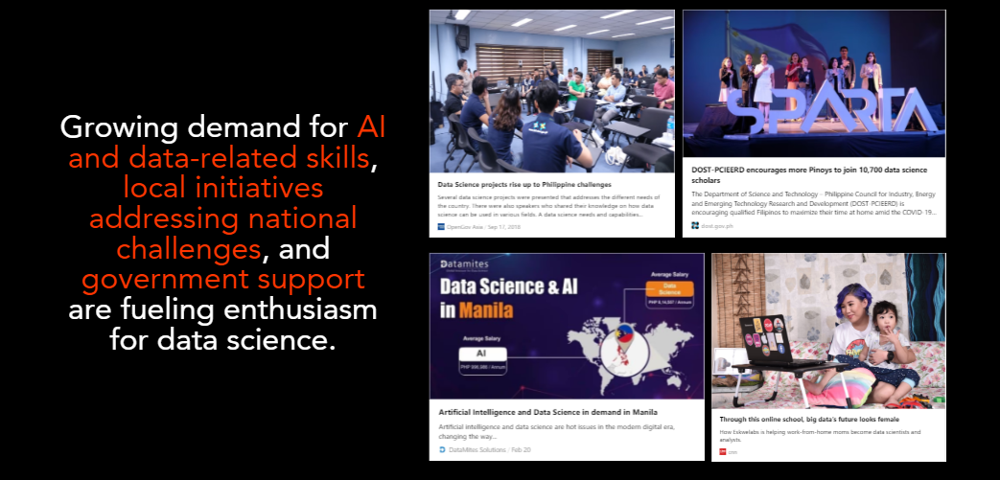

# About the Data

The dataset comprises Facebook page data relevant to the Philippines, spanning from January 2021 to August 2023. The dataset contains various attributes that capture information about different Facebook pages and their posts, with a focus on topics related to "data science," "machine learning," and "artificial intelligence."

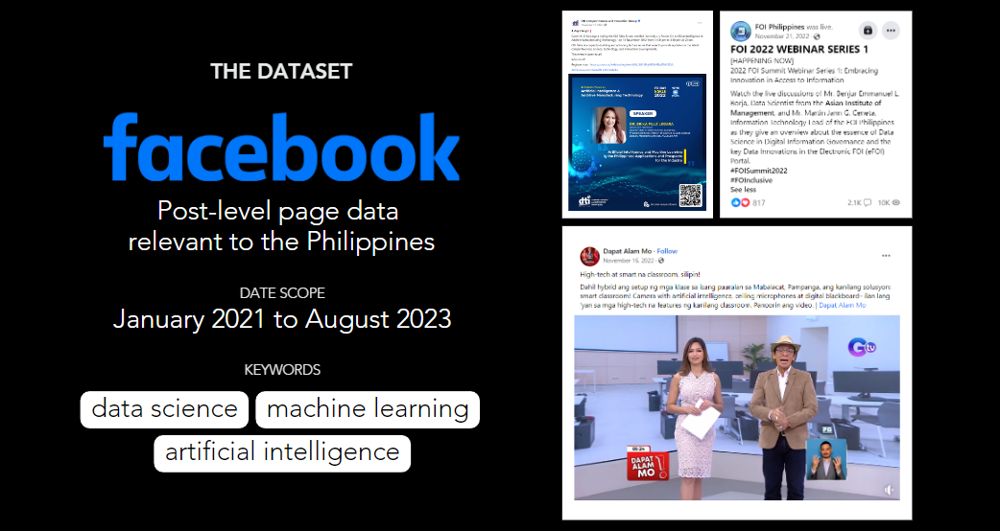

This dataset, comprising 18,913 rows of data, was scraped from publicly accessible Facebook pages. It offers a comprehensive array of attributes, including page names, categories, post timestamps, types, and clustering labels. Additionally, it includes post messages and detailed engagement metrics, encompassing likes, comments, shares, as well as emotional reactions like Love, Wow, Haha, Sad, Angry, and Care. This resource-rich dataset is a valuable asset for researchers and analysts exploring data science, machine learning, and artificial intelligence trends on Facebook in the Philippines from January 2021 to August 2023.


<span style="font-size: 14px">
    <center><b>Table 1. Facebook Raw Data Key Attributes</b></center>
</span>

| Attribute              | Description                                                   |
|:-----------------------|:--------------------------------------------------------------|
| Page Name              | The name of the Facebook page.                                |
| Page Category          | The category or classification of the Facebook page.         |
| Post Created           | The timestamp of when a post was created.                     |
| Post Created Date      | The date when a post was created.                              |
| Type                   | The type of post (e.g., Photo, Native Video, Link).            |
| Cluster                | A clustering label; group of page categories.                               |
| Page Admin Top Country | The top country associated with the page admin.                |
| Message                | The content or message of the post.                           |
| Total Interactions     | The total number of interactions (likes, comments, shares, etc.) for each post. |
| Likes, Comments, Shares, Love, Wow, Haha, Sad, Angry, Care | The breakdown of specific interactions for each post. |




# Methodology

## General Methodology Framework

The methodology presents a structured approach to analyze data science engagement trends in the Philippines, incorporating a blend of statistical and machine learning models. [2] This comprehensive framework aims to reveal nuanced insights and forecasts regarding data science engagement to uncover the hidden patterns and trends that may not be immediately evident from the original dataset.

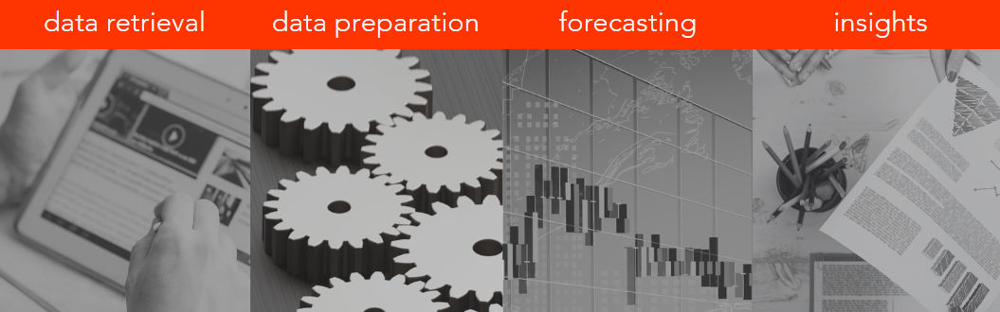

**`Data Retrieval`**

- Utilized the Facebook API to collect data related to the Philippines from January 2021 to August 2023.
- Focused on topics like "data science," "machine learning," and "artificial intelligence."

**`Data Preparation`**

- Preprocessed and filtered the dataset to retain the top 40 categories with the highest post counts.
- Excluded lower sections of the dataset with limited posts.
- Conducted data cleaning to ensure data quality.
- Restructured the dataframe to align with the Nixtla Hierarchical Clustering Library format.
- Introduced 'Date' ('ds') and corresponding 'y' values.

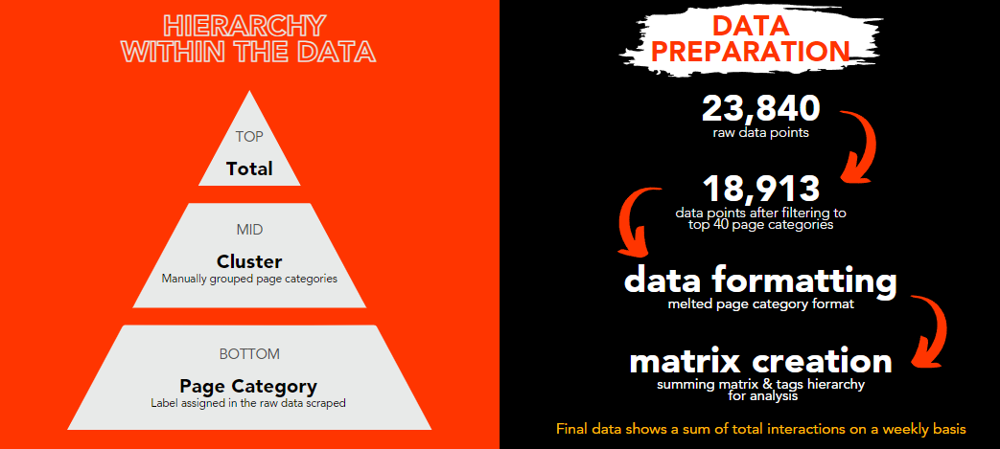

**`Data Exploration`**

- Explored dataset characteristics through summary statistics, data visualizations, and trend identification.

**`Forecasting`**

- Partitioned the time series data into training and test sets.
- Set a forecasting horizon of 12 weeks, aligning with quarterly marketing forecast conventions.
- Evaluated various forecasting models, including statistical and machine learning models. [2]
- Selected the most accurate model for generating out-of-sample forecasts.

**`Insights Generation`**

- Analyzed and interpreted findings and insights from the data.
- Identified trends in data science engagement, categorizing them as positive, neutral, or declining.
- Employed bootstrapped intervals to evaluate uncertainty and anticipate potential future trajectories in data science engagement. [11, 12]


## Forecasting Methodology

On a more detailed level, the forecasting technique employed in this analysis leverages the Nixtla Hierarchical Forecasting Library, a powerful tool designed for hierarchical forecasting tasks. [3] Hierarchical forecasting is a method that takes into account the hierarchical structure of the data, such as multiple levels of aggregation or categories, and provides forecasts at various levels of granularity. [4, 5]

The Nixtla library facilitates this process by allowing us to aggregate our data into hierarchical structures based on topics, clusters, and categories, reflecting the natural organization of our dataset. This hierarchical approach enables us to generate forecasts not only at the overall data science engagement level but also at more specific levels, providing insights into how different topics, clusters, and categories contribute to the overarching trend.

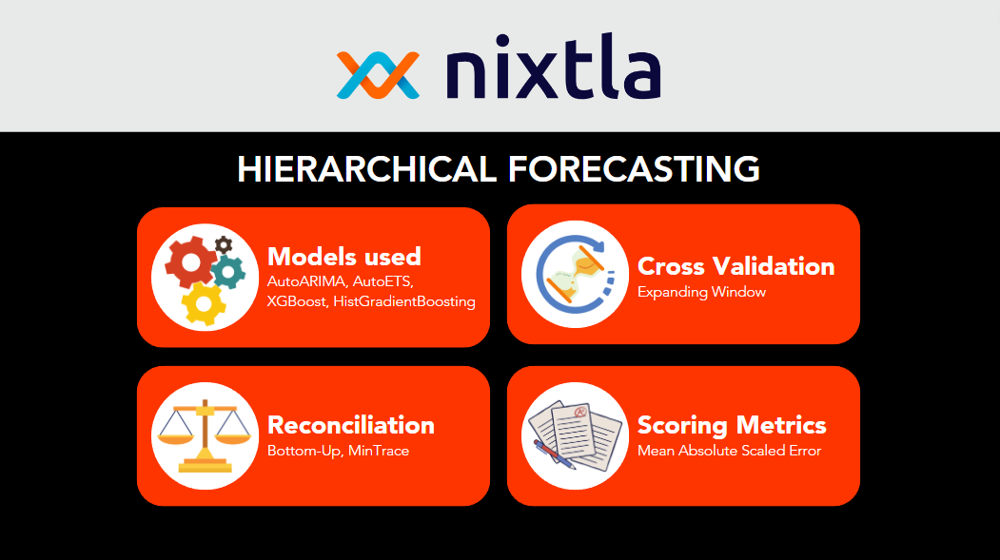

**`Model Selection`**

- Employed a combination of statistical and machine learning models, including AUTOARIMA, AUTOETS, XGBoost, and HistGradientBoosting, to generate forecasts. [2]

**`Cross Validation`**

- Utilized an expanding window cross-validation strategy to assess the performance of forecasting models. [6]
- Evaluated the models through repeated iterations where the training set expanded while the validation period remained fixed at 12 weeks.

**`Reconciliation`**

- Applied reconciliation techniques to align forecasts at different hierarchical levels.
- Implemented both the Bottom-up [7] and MinTrace (method='ols') [8] approaches to enhance forecast coherence.

**`Scoring Metrics`**

- Employed multiple scoring metrics, including Mean Absolute Error (MAE), Mean Absolute Scaled Error (MASE), Root Mean Squared Error (RMSE), and Mean Absolute Percentage Error (MAPE), to evaluate forecast accuracy.
- Gave particular emphasis to MASE as a key metric for assessing the relative improvement of forecasts over a naive baseline.

# Data Exploration

In this particular section, a thorough examination of the provided raw data is undertaken to identify those specific portions that are suitable for conducting a temporal analysis pertaining to engagement levels in the domains of data science, artificial intelligence, and machine learning within the digital space.

## Raw Data

### Data Loading

To initiate the process, the scraped Facebook data is loaded from the 'data' directory into a pandas dataframe, which greatly streamlines subsequent data handling and manipulation tasks.

In [5]:
# Read 'ph_ai_engagement.csv' into 'df' and display the first 5 rows.
df = pd.read_csv('data/ph_ai_engagement.csv', low_memory=False)
df.head(5)

,Page Name,Page Category,Post Created,Post Created Date,Type,Cluster,Page Admin Top Country,Message,Total Interactions,Likes,Comments,Shares,Love,Wow,Haha,Sad,Angry,Care
0,Genshin Impact,VIDEO_GAMES,2021-07-22 21:00:07 PST,2021-07-22,Photo,Entertainment and Media,CN,"Aloy's Character Overview ""Everything I do is ...","142,492",59709,7639,18833,32173,21776,965,231,94,1072
1,K.R.A Stories,VIDEO_CREATOR,2022-08-21 20:11:26 PST,2022-08-21,Native Video,Entertainment and Media,PH,Mga nakakakilabot na sinabi ng mga AI o Artifi...,"134,698",71551,4578,22480,2738,27904,2627,1816,566,438
2,Samsung Electronics,ELECTRONICS,2022-11-16 17:00:30 PST,2022-11-16,Link,Business and Technology,KR,"Hyperscale AI can recognize, analyze and produ...","133,043",127413,826,287,2057,1136,88,16,23,1197
3,Dapat Alam Mo,MEDIA_NEWS_COMPANY,2022-11-16 15:40:27 PST,2022-11-16,Native Video,Entertainment and Media,PH,"High-tech at smart na classroom, silipin! Dahi...","56,024",14849,944,13305,13210,13279,91,15,7,324
4,Project Nightfall,PERSON,2023-03-10 21:00:01 PST,2023-03-10,Native Video,Miscellaneous,PH,Is artificial intelligence creating a generati...,"43,862",24009,1431,6548,3721,7112,355,405,70,211


### Data Statistics

Following this, there is a progression towards the identification of fundamental statistics concerning the unprocessed data. This includes ascertaining its structure, pinpointing the count of missing values, and generating brief statistical overviews encompassing metrics like count, mean, standard deviation, and others.

#### Shape

The dataframe's shape, denoted as (23840, 18), offers a succinct overview of its structure. With 23,840 rows, each representing a distinct data point or observation, and 18 columns containing various attributes and metrics, this information serves as a fundamental reference point for comprehending the dataset's size and complexity.

In [6]:
# Get the shape of the DataFrame 'df'
df.shape

(23840, 18)

#### Null Values

It's evident that the majority of columns, including `Page Name`, `Page Category`, `Post Created`, `Post Created Date`, `Type`, `Cluster`, `Total Interactions`, `Likes`, `Comments`, `Shares`, `Love`, `Wow`, `Haha`, `Sad`, `Angry`, and `Care`, exhibit no missing data, as indicated by a count of 0. However, two columns stand out with notable missing entries: 'Page Admin Top Country' with 869 missing values and 'Message' with 2700 missing entries.

In [7]:
# Calculate the number of missing values in each column of 'df'
df.isna().sum()

Page Name                    0
Page Category                0
Post Created                 0
Post Created Date            0
Type                         0
Cluster                      0
Page Admin Top Country     869
Message                   2700
Total Interactions           0
Likes                        0
Comments                     0
Shares                       0
Love                         0
Wow                          0
Haha                         0
Sad                          0
Angry                        0
Care                         0
dtype: int64

#### Quick Statistics

The quick statistics of the dataframe were taken to provide a rapid and concise overview of the central tendencies, spread, and distribution of numerical attributes within the dataset.

In [8]:
# Generate summary statistics for 'df'
df.describe()

,Likes,Comments,Shares,Love,Wow,Haha,Sad,Angry,Care
count,23840.000000,23840.000000,23840.000000,23840.000000,23840.000000,23840.000000,23840.000000,23840.000000,23840.000000
mean,77.516275,9.075419,25.672190,28.633767,8.198742,8.613884,1.565310,0.238423,1.256628
std,1134.358685,118.556513,316.363844,336.538932,264.267086,170.419644,45.610125,5.622426,17.803091
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,4.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,18.000000,1.000000,5.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,127413.000000,7639.000000,22480.000000,32173.000000,27904.000000,12332.000000,4456.000000,566.000000,1197.000000


## Data Preprocessing

Following this, the objective is to preprocess and filter the data, with the intention of retaining solely the top 40 categories characterized by the highest post counts. The lower section of the dataset is excluded from consideration, as it is deemed irrelevant to the analysis due to its notably limited number of posts.

In [9]:
# Filter the data to the top 40 only
cat_list = df['Page Category'].value_counts().head(40).index.tolist()
df = df.loc[df['Page Category'].isin(cat_list)]

Subsequently, there is a progression towards converting all columns to their appropriate data types. This transformation encompasses changing the `Total Interactions` column from a string to a float data type. Additionally, any null values within the `Message` column are addressed by filling them with empty spaces.

In [10]:
# Remove commas and convert 'Total Interactions' to float
df['Total Interactions'] = df['Total Interactions'].str.replace(',', '')
df['Total Interactions'] = df['Total Interactions'].astype('float')

# Fill NaN values in the 'Message' column with an empty string
df['Message'] = df['Message'].fillna('')
df

,Page Name,Page Category,Post Created,Post Created Date,Type,Cluster,Page Admin Top Country,Message,Total Interactions,Likes,Comments,Shares,Love,Wow,Haha,Sad,Angry,Care
1,K.R.A Stories,VIDEO_CREATOR,2022-08-21 20:11:26 PST,2022-08-21,Native Video,Entertainment and Media,PH,Mga nakakakilabot na sinabi ng mga AI o Artifi...,134698.0,71551,4578,22480,2738,27904,2627,1816,566,438
3,Dapat Alam Mo,MEDIA_NEWS_COMPANY,2022-11-16 15:40:27 PST,2022-11-16,Native Video,Entertainment and Media,PH,"High-tech at smart na classroom, silipin! Dahi...",56024.0,14849,944,13305,13210,13279,91,15,7,324
4,Project Nightfall,PERSON,2023-03-10 21:00:01 PST,2023-03-10,Native Video,Miscellaneous,PH,Is artificial intelligence creating a generati...,43862.0,24009,1431,6548,3721,7112,355,405,70,211
5,Trend Micro AMEA,PRODUCT_SERVICE,2022-12-15 14:30:09 PST,2022-12-15,Link,Business and Technology,IN,We are proud to announce our partnership with ...,31275.0,30713,238,24,249,15,10,2,0,24
7,INQUIRER.net,MEDIA_NEWS_COMPANY,2022-02-22 13:59:14 PST,2022-02-22,Photo,Entertainment and Media,PH,A third-year engineering student from India’s ...,30068.0,3661,379,7121,14573,4053,24,3,0,254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23834,Candy Magazine,TOPIC_PUBLISHER,2022-10-14 09:00:00 PST,2022-10-14,Link,Miscellaneous,PH,Professionals in data science and analytics ar...,0.0,0,0,0,0,0,0,0,0,0
23835,Candy Magazine,TOPIC_PUBLISHER,2021-03-02 08:59:05 PST,2021-03-02,Link,Miscellaneous,PH,This industry is booming and has no signs of s...,0.0,0,0,0,0,0,0,0,0,0
23836,Candy Magazine,TOPIC_PUBLISHER,2021-02-20 01:00:01 PST,2021-02-20,Link,Miscellaneous,PH,Professionals in data science and analytics ar...,0.0,0,0,0,0,0,0,0,0,0
23837,Definitely Filipino,NEWS_SITE,2023-06-02 09:28:30 PST,2023-06-02,YouTube,Entertainment and Media,PH,We asked A.I. (Artificial Intelligence) to cre...,0.0,0,0,0,0,0,0,0,0,0


Following the data organization, the objective is to adapt the dataframe into a structure compatible with the Nixtla Hierarchical Clustering Library. In this modified format, the initial columns will align with each hierarchical level, with column names denoting the respective hierarchy names. Precisely, the highest level will be designated as `Topic`, the intermediate level as `Cluster`, and the lowest level as `Category`. Alongside this restructuring, the transformed dataframe will incorporate a 'Date' column referred to as 'ds,' accompanied by its corresponding 'y' values.

In [11]:
# Create the top-level hierarchy
df['Topic'] = 'Data Science'

# Retain relevant columns
df_engage = df[['Topic', 'Cluster', 'Page Category',
                      'Post Created Date', 'Total Interactions']].copy()

# Rename columns to nixtla format
df_engage = df_engage.rename(columns={'Page Category': 'Category',
                                      'Post Created Date': 'ds',
                                      'Total Interactions': 'y'})
# Convert 'ds' column to datetime format
df_engage['ds'] = pd.to_datetime(df_engage['ds'])

# Group by 'Category' and aggregate weekly
Y_df = (df_engage.groupby(['Topic', 'Cluster', 'Category',
                           pd.Grouper(key='ds', freq='W')])['y']
                 .sum()
                 .reset_index())
Y_df

,Topic,Cluster,Category,ds,y
0,Data Science,Business and Technology,COMPUTER_COMPANY,2021-01-10,34.0
1,Data Science,Business and Technology,COMPUTER_COMPANY,2021-01-17,7.0
2,Data Science,Business and Technology,COMPUTER_COMPANY,2021-01-24,18.0
3,Data Science,Business and Technology,COMPUTER_COMPANY,2021-01-31,29.0
4,Data Science,Business and Technology,COMPUTER_COMPANY,2021-02-07,22.0
...,...,...,...,...,...
4200,Data Science,Miscellaneous,TOPIC_REAL_ESTATE,2023-06-11,23.0
4201,Data Science,Miscellaneous,TOPIC_REAL_ESTATE,2023-06-18,38.0
4202,Data Science,Miscellaneous,TOPIC_REAL_ESTATE,2023-06-25,20.0
4203,Data Science,Miscellaneous,TOPIC_REAL_ESTATE,2023-07-02,36.0


Continuing, the assignment at hand entails the creation of a list, aptly named `spec`, which encapsulates the hierarchical structure of our dataset. Following this step, we will employ the aggregate function from Nixtla's Hierarchical Clustering Library, utilizing `Y_df` and `spec` as inputs. This operation will result in the generation of `hierarchical time series data`, the corresponding `summation matrix`, and the `pertinent tags`.

In [11]:
# Define hierarchical structure 'spec' and aggregate the DataFrame 'Y_df'
spec = [
    ['Topic'],
    ['Topic', 'Cluster'],
    ['Topic', 'Cluster', 'Category']
]

Y_df, S_df, tags = aggregate(Y_df, spec, is_balanced=False)
Y_df = Y_df.reset_index()

# Impute zeros with moving average
Y_df = impute_zeros_with_moving_average(Y_df)
Y_df

/opt/conda/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


,unique_id,ds,y
0,Data Science,2021-01-03,417.0
1,Data Science,2021-01-10,3969.0
2,Data Science,2021-01-17,12556.0
3,Data Science,2021-01-24,2656.0
4,Data Science,2021-01-31,25769.0
...,...,...,...
6575,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-06,13.0
6576,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-13,13.0
6577,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-20,13.0
6578,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-27,13.0


In [12]:
# Display the first 5 rows and first 5 columns of the summing matrix
S_df.iloc[:5, :5]

,Data Science/Business and Technology/COMPUTER_COMPANY,Data Science/Business and Technology/CONSULTING_COMPANY,Data Science/Business and Technology/FINANCIAL_SERVICES,Data Science/Business and Technology/INFORMATION_TECHNOLOGY_COMPANY,Data Science/Business and Technology/PRODUCT_SERVICE
Data Science,1.0,1.0,1.0,1.0,1.0
Data Science/Business and Technology,1.0,1.0,1.0,1.0,1.0
Data Science/Community and Non-Profit,0.0,0.0,0.0,0.0,0.0
Data Science/Education and Learning,0.0,0.0,0.0,0.0,0.0
Data Science/Entertainment and Media,0.0,0.0,0.0,0.0,0.0


Below are the delineated hierarchies within the dataset.

In [13]:
tags

{'Topic': array(['Data Science'], dtype=object),
 'Topic/Cluster': array(['Data Science/Business and Technology',
        'Data Science/Community and Non-Profit',
        'Data Science/Education and Learning',
        'Data Science/Entertainment and Media',
        'Data Science/Government and Organizations',
        'Data Science/Miscellaneous'], dtype=object),
 'Topic/Cluster/Category': ['Data Science/Business and Technology/COMPUTER_COMPANY',
  'Data Science/Business and Technology/CONSULTING_COMPANY',
  'Data Science/Business and Technology/FINANCIAL_SERVICES',
  'Data Science/Business and Technology/INFORMATION_TECHNOLOGY_COMPANY',
  'Data Science/Business and Technology/PRODUCT_SERVICE',
  'Data Science/Business and Technology/RECRUITER',
  'Data Science/Business and Technology/SCIENCE_ENGINEERING',
  'Data Science/Business and Technology/SCIENCE_SITE',
  'Data Science/Business and Technology/SOFTWARE_COMPANY',
  'Data Science/Business and Technology/TOPIC_BUSINESS_SERVICES',
  '

## Inspecting the Data

There is a significant variance in the number of posts pertaining to data science, artificial intelligence, and machine learning across different Page Categories. The `MEDIA_NEWS_COMPANY` category stands out as the most prolific, featuring a substantial 2985 posts related to these topics. In contrast, the `NON_PROFIT` category demonstrates the least representation among the top 10, with only 561 posts dedicated to these subjects. This disparity highlights the diverse levels of engagement and focus on the fields of data science, artificial intelligence, and machine learning across various Page Categories within the digital space, reflecting content distribution and priorities.

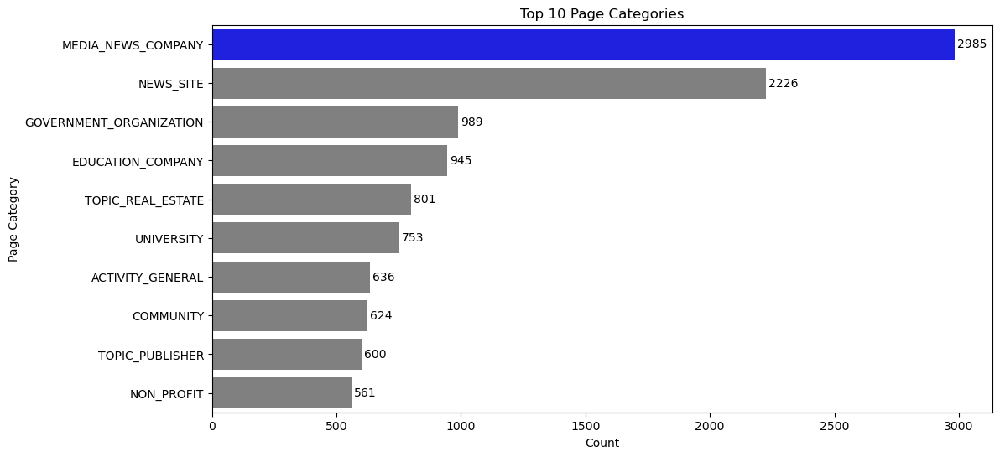

In [15]:
# Get the top 10 categories
top_categories = df['Page Category'].value_counts().head(10)

# Create a color list
colors = ['blue' if cat == top_categories.index[0] else 'gray' for cat in top_categories.index]

# Create the horizontal barplot
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=top_categories.values, y=top_categories.index, palette=colors)

# Add data labels
for i, v in enumerate(top_categories.values):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Customize the plot
plt.xlabel('Count')
plt.ylabel('Page Category')
plt.title('Top 10 Page Categories')
plt.show()

In the context of Clusters, there is a notable discrepancy in the number of posts dedicated to data science, artificial intelligence, and machine learning. The `Entertainment and Media` Cluster takes the lead, exhibiting a substantial 7510 posts. Conversely, the `Government and Organizations` Cluster demonstrates the least representation, with only 1659 posts.

This divergence in post frequencies can be attributed to the varying thematic priorities and objectives of different Clusters. The `Entertainment and Media` Cluster, being highly focused on content creation, often explores the applications and impacts of data science, artificial intelligence, and machine learning within the entertainment and media industry, resulting in a higher number of related posts. On the other hand, the `Government and Organizations` Cluster may prioritize other themes and initiatives, leading to a lower representation of posts in this domain. 

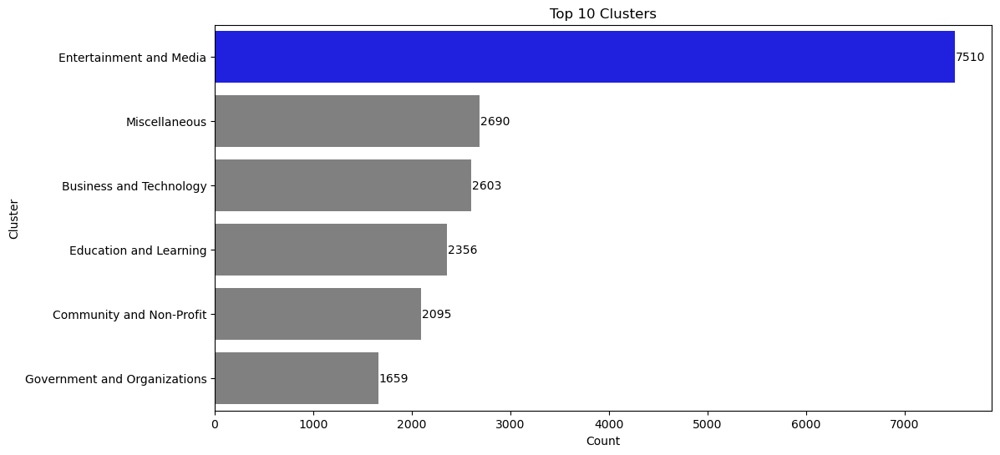

In [16]:
# Get the top 10 clusters
top_clusters = df['Cluster'].value_counts().head(10)

# Create a color list
colors = ['blue' if cluster == top_clusters.index[0] else 'gray' for cluster in top_clusters.index]

# Create the horizontal barplot
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=top_clusters.values, y=top_clusters.index, palette=colors)

# Add data labels
for i, v in enumerate(top_clusters.values):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Customize the plot
plt.xlabel('Count')
plt.ylabel('Cluster')
plt.title('Top 10 Clusters')
plt.show()

There is a notable variation in the type of data science content. The `Photo` post type takes the lead with 9107 posts, followed closely by `Link` with 7413 posts dedicated to these subjects. In contrast, `Video` and `YouTube` post types exhibit the least representation, with only 23 and 232 posts, respectively, related to these topics.

This disparity in post frequencies can be attributed to the nature of content associated with each post type. `Photo` and `Link` posts often serve as platforms for discussing data-driven insights and sharing informative articles or resources related to data science, artificial intelligence, and machine learning. On the other hand, `Video` and `YouTube` posts, while less frequent, might delve into more in-depth discussions or tutorials in these domains, explaining their comparatively lower occurrence.

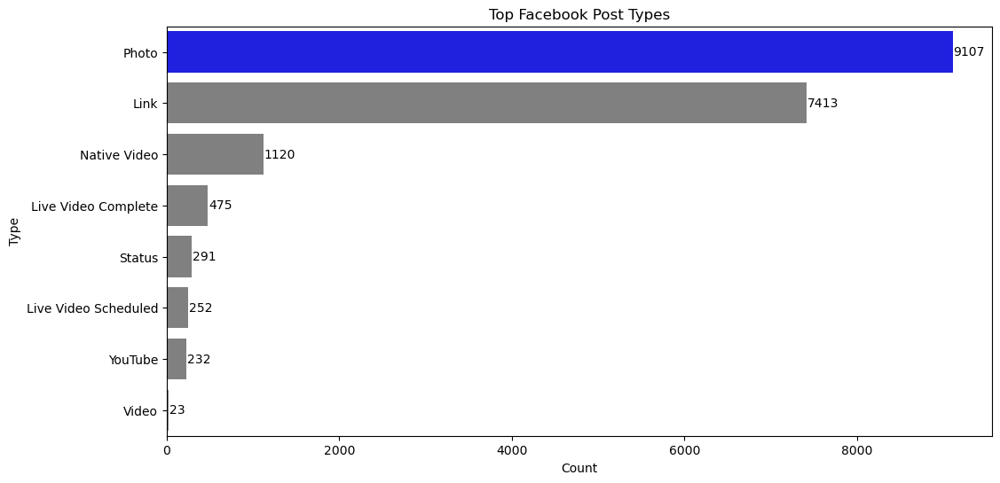

In [17]:
# Count the occurrences of each unique value
type_counts = df['Type'].value_counts()

# Create a color list
colors = ['blue' if t == type_counts.index[0] else 'gray' for t in type_counts.index]

# Create the horizontal barplot
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=type_counts.values, y=type_counts.index, palette=colors)

# Add data labels
for i, v in enumerate(type_counts.values):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Customize the plot
plt.xlabel('Count')
plt.ylabel('Type')
plt.title('Top Facebook Post Types')
plt.show()

Interestingly, `Upswing Learning Center CPD Provider`, while not primarily a data science page, garnered a significant number of posts due to its association with topics such as "data science," "machine learning," and "artificial intelligence." This inclusion can likely be attributed to the algorithm's recognition of relevant keywords or thematic overlap, even if the page's primary focus extends beyond these domains.

However, the rest of the top 10, including organizations like `Asian Institute of Management`, `Globe Hackers`, `Project SPARTA PH`, and `Eskwelabs`, represent the most prominent organizations that consistently engage with and discuss data science topics. Notably, `Asian Institute of Management`, as the premier data science organization, holds a prominent position at the top, underscoring its leadership in the field. 

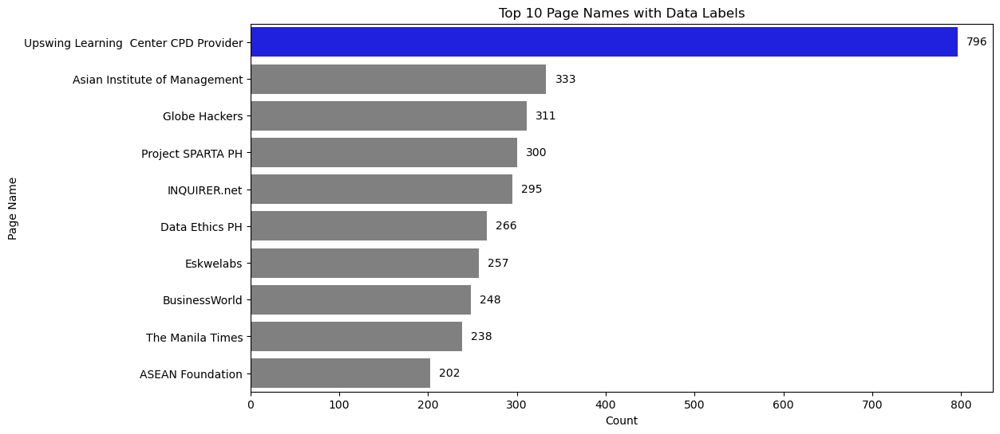

In [18]:
# Get the top 10 page names
top_page_names = df['Page Name'].value_counts().head(10)

# Create a color list
colors = ['blue' if name == top_page_names.index[0] else 'gray' for name in top_page_names.index]

# Create the horizontal barplot
plt.figure(figsize=(12, 6))
ax = sns.barplot(x=top_page_names.values, y=top_page_names.index, palette=colors)

# Add data labels
for i, v in enumerate(top_page_names.values):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Customize the plot
plt.xlabel('Count')
plt.ylabel('Page Name')
plt.title('Top 10 Page Names with Data Labels')
plt.show()

Looking at the weekly volume of data science content, the time series shows a relatively stable number of posts from 2021 to 2022. However, a significant spike in post activity is evident in 2023, particularly in the Philippines. This surge can be attributed to several factors, including the growing interest and adoption of data science, artificial intelligence, and machine learning in the region. Additionally, advancements in technology, increased access to digital platforms, and the recognition of the value of these fields in various sectors may have contributed to the notable increase in posts. Furthermore, events, conferences, or major developments related to data science and technology this year have generated heightened online discussions and content creation, resulting in the observed spike in posts during 2023.

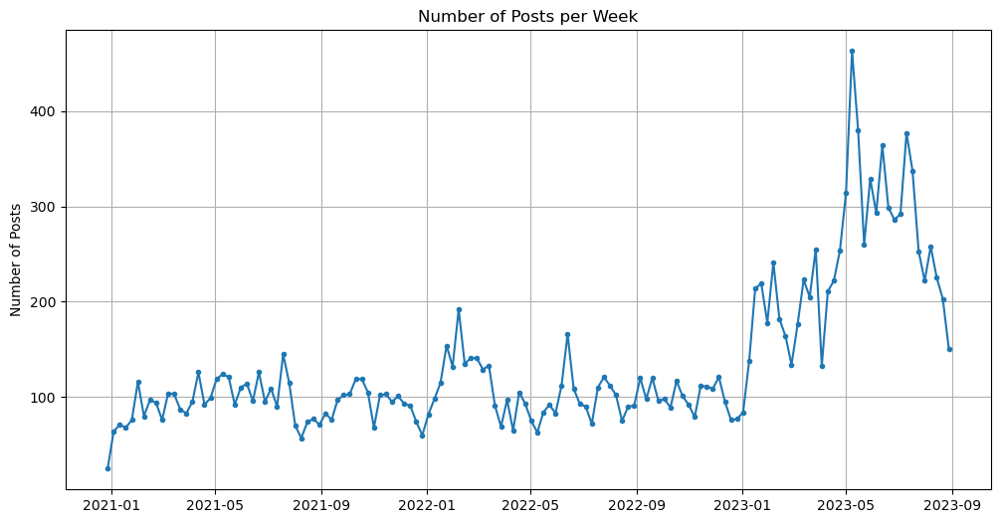

In [19]:
# Ensure 'Post Created Date' is in datetime format
df['Post Created Date'] = pd.to_datetime(df['Post Created Date'])

# Group by week and count the number of posts per week
post_counts = df.groupby(df['Post Created Date'].dt.to_period('W')).size()

# Create a line plot
plt.figure(figsize=(12, 6))
plt.plot(post_counts.index.to_timestamp(), post_counts.values, marker='.', linestyle='-')
plt.ylabel('Number of Posts')
plt.title('Number of Posts per Week')
plt.grid(True)

plt.show()

Next, we turn our attention to the weekly total interactions with data science-related content. This series holds greater relevance and will be the focus of our forecasting efforts later on. Examining the plot, it's evident that there is a notable surge in engagement levels for data science content as we approach the fourth quarter of 2022.

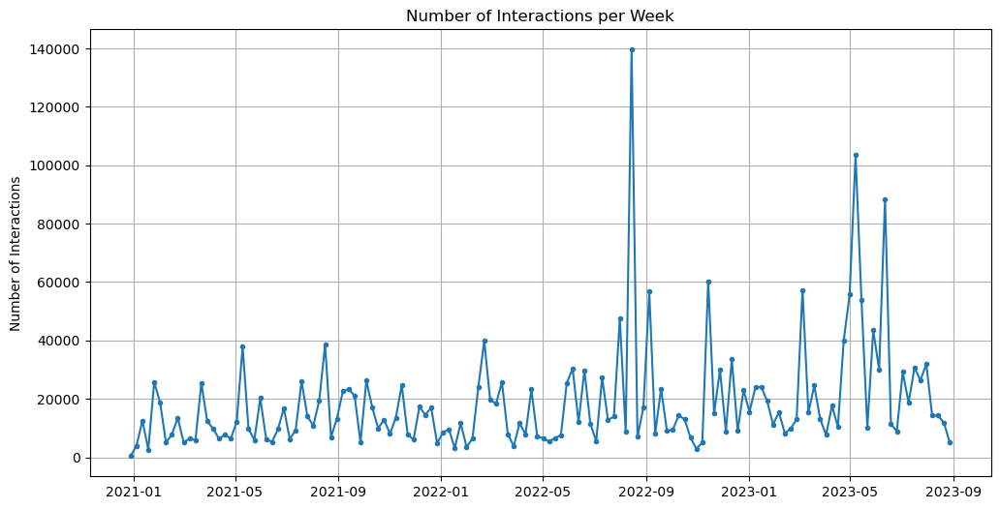

In [21]:
# Group by week and count the total interactions per week
post_interactions = df.groupby(df['Post Created Date'].dt.to_period('W'))['Total Interactions'].sum()

# Create a line plot
plt.figure(figsize=(12, 6))
plt.plot(post_interactions.index.to_timestamp(), post_interactions.values, marker='.', linestyle='-')
plt.ylabel('Number of Interactions')
plt.title('Number of Interactions per Week')
plt.grid(True)

plt.show()

To contexualize this time series, we have a breakdown of the top 10 Page Categories and Clusters based on their total interactions, with likes constituting the majority of these interactions. Shares and love reactions closely follow as the second and third most common forms of engagement. This breakdown highlights the prominence of likes as a primary mode of user interaction with content across various Page Categories. It also underscores the significance of shares and love reactions as meaningful indicators of user engagement within these digital spaces.

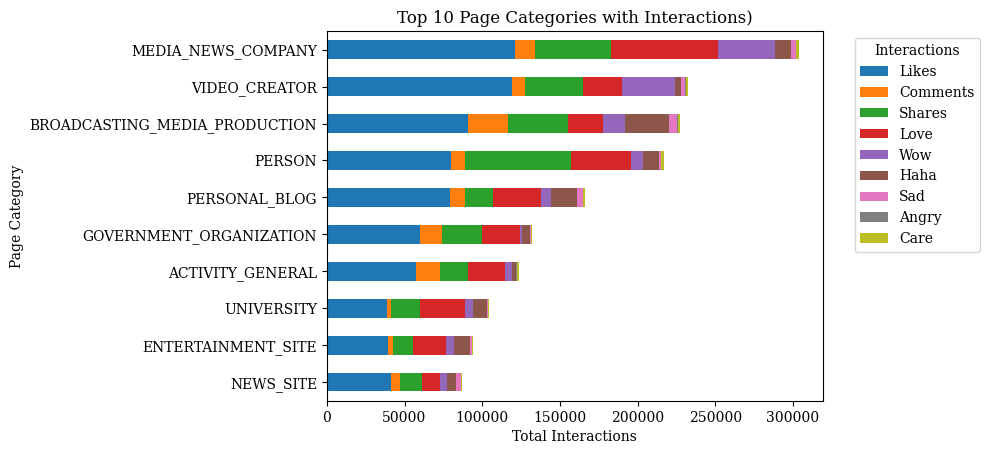

In [19]:
# Group the data by Page Category and calculate the sum of interactions
interaction_columns = ['Likes', 'Comments', 'Shares', 'Love', 'Wow', 'Haha', 'Sad', 'Angry', 'Care']
df['Total Interactions'] = df[interaction_columns].sum(axis=1)
interactions_by_category = df.groupby('Page Category')[interaction_columns].sum()

# Calculate the total interactions for each category
total_interactions_by_category = interactions_by_category.sum(axis=1)
interactions_by_category['Total Interactions'] = total_interactions_by_category

# Sort the categories by total interactions in ascending order
sorted_categories = interactions_by_category.sort_values(by='Total Interactions', ascending=True)

# Select the top 10 categories
top_10_categories = sorted_categories.tail(10)

# Create a horizontal stacked barplot for the top 10 categories
# plt.figure(figsize=(12, 6))
top_10_categories[interaction_columns].plot(kind='barh', stacked=True)
plt.xlabel('Total Interactions')
plt.ylabel('Page Category')
plt.title('Top 10 Page Categories with Interactions)')
plt.legend(title='Interactions', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

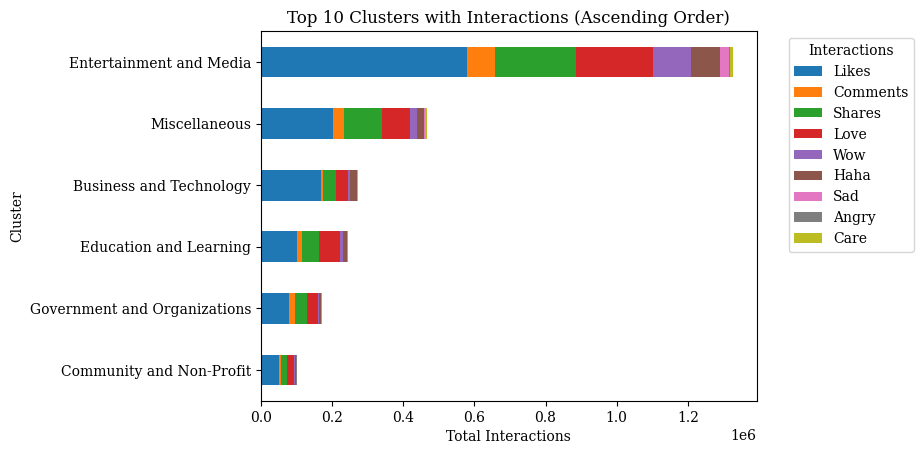

In [20]:
# Group the data by Cluster and calculate the sum of interactions
interaction_columns = ['Likes', 'Comments', 'Shares', 'Love', 'Wow', 'Haha', 'Sad', 'Angry', 'Care']
df['Total Interactions'] = df[interaction_columns].sum(axis=1)
interactions_by_cluster = df.groupby('Cluster')[interaction_columns].sum()

# Calculate the total interactions for each cluster
total_interactions_by_cluster = interactions_by_cluster.sum(axis=1)
interactions_by_cluster['Total Interactions'] = total_interactions_by_cluster

# Sort the clusters by total interactions in ascending order
sorted_clusters = interactions_by_cluster.sort_values(by='Total Interactions', ascending=True)

# Select the top 10 clusters
top_10_clusters = sorted_clusters.tail(10)

# Create a horizontal stacked barplot for the top 10 clusters
# plt.figure(figsize=(12, 6))
top_10_clusters[interaction_columns].plot(kind='barh', stacked=True)
plt.xlabel('Total Interactions')
plt.ylabel('Cluster')
plt.title('Top 10 Clusters with Interactions (Ascending Order)')
plt.legend(title='Interactions', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

Finally, presented here is a pairplot illustrating the relationships between each component of engagement reactions, ranging from total interactions to their individual constituents. This visualization provides insights into the characteristics of each post concerning their engagement breakdown.

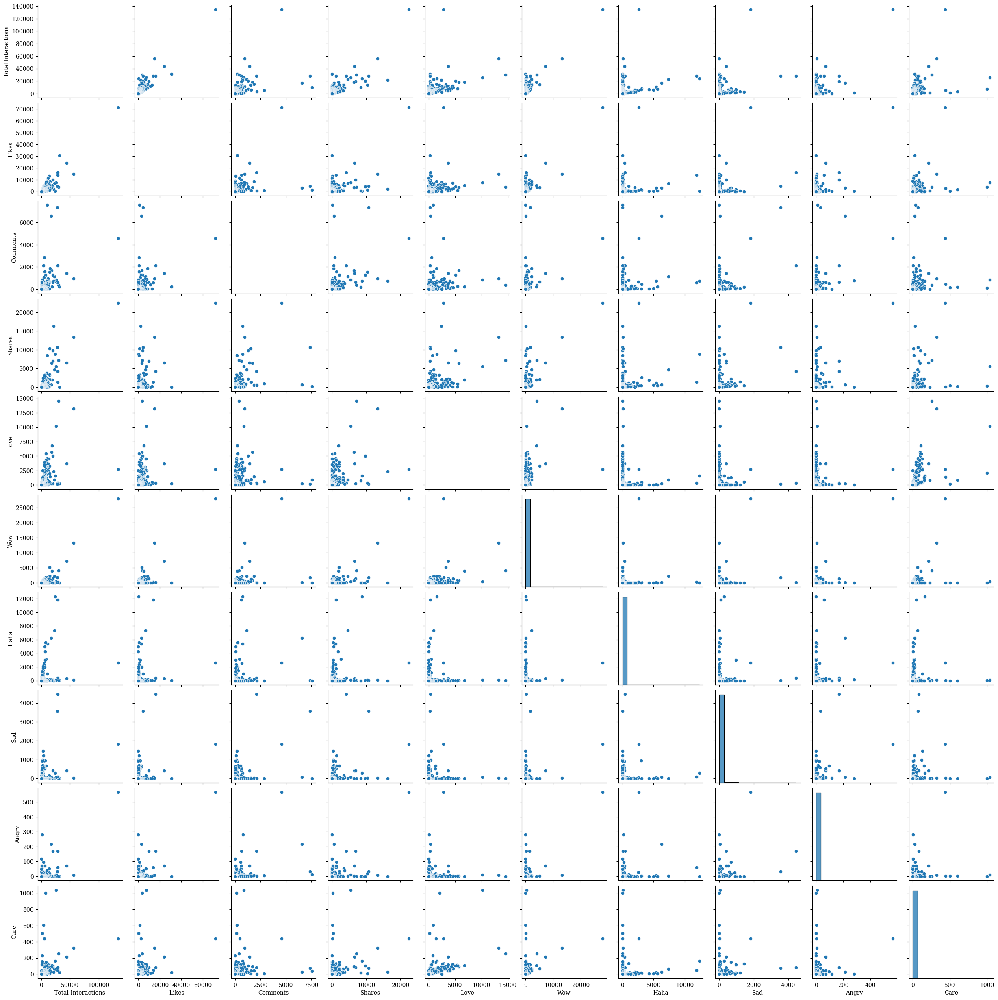

In [21]:
# Select the numerical columns for the pair plot
numerical_columns = ['Total Interactions', 'Likes', 'Comments', 'Shares',
                     'Love', 'Wow', 'Haha', 'Sad', 'Angry', 'Care']

# Create a pair plot
sns.pairplot(df[numerical_columns])
plt.show()

## Inspecting the Hierarchical Timeseries

Further enhancement of our understanding can be achieved through the visualization of the summation matrix using the 'HierarchicalPlot' function, which is accessible within the library. This visualization offers a comprehensive representation of the matrix, replacing zeroes and ones with a visually intuitive display. In this representation, the upper section illustrates the top-level structure, the lower identity matrix signifies the individual bottom-level time series, and the middle section depicts the amalgamation of the bottom-level time series that constitute the middle level.

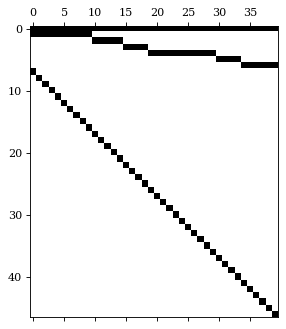

In [22]:
# Create a HierarchicalPlot object 'hplot' and plot the summing matrix
hplot = HierarchicalPlot(S=S_df, tags=tags)
hplot.plot_summing_matrix()

Next, there is a compelling need to meticulously inspect each time series, discerning and visually observing the distinct characteristics and trends that lie embedded within them.

/home/msds2023/byepes/.local/lib/python3.10/site-packages/hierarchicalforecast/utils.py:347: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(len(linked_series), 1, figsize=(20, 2 * len(linked_series)))


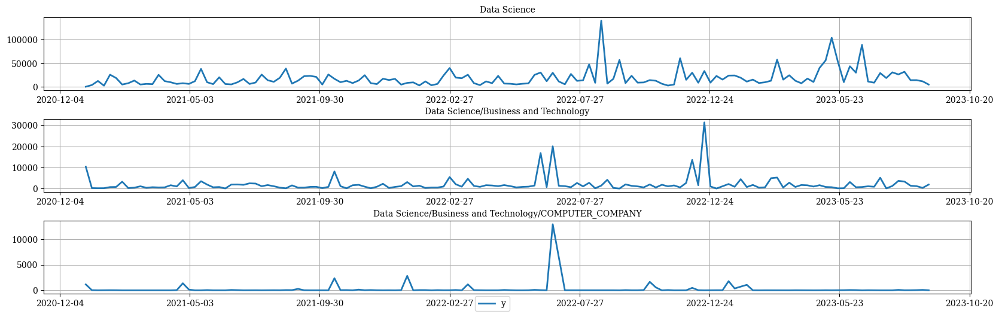

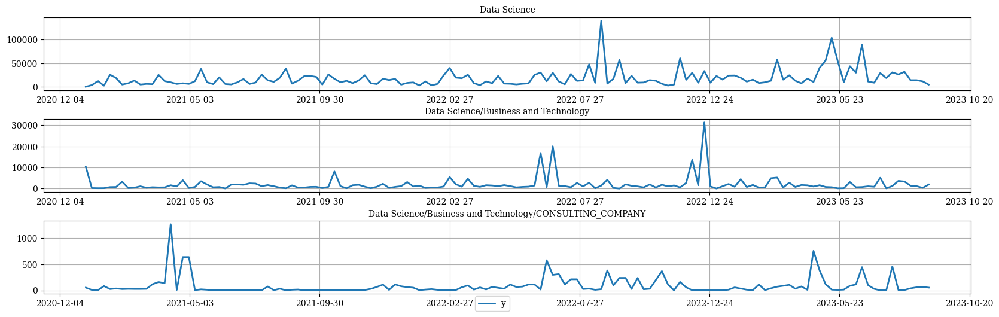

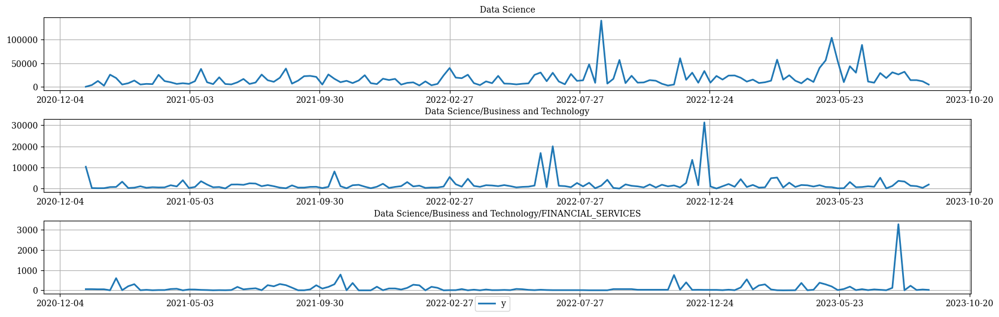

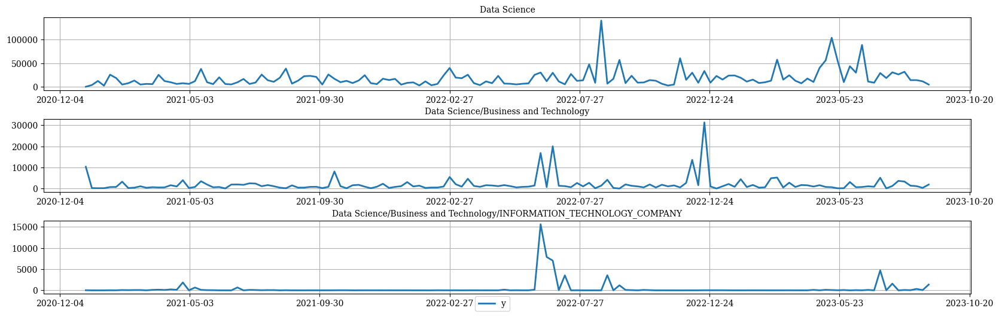

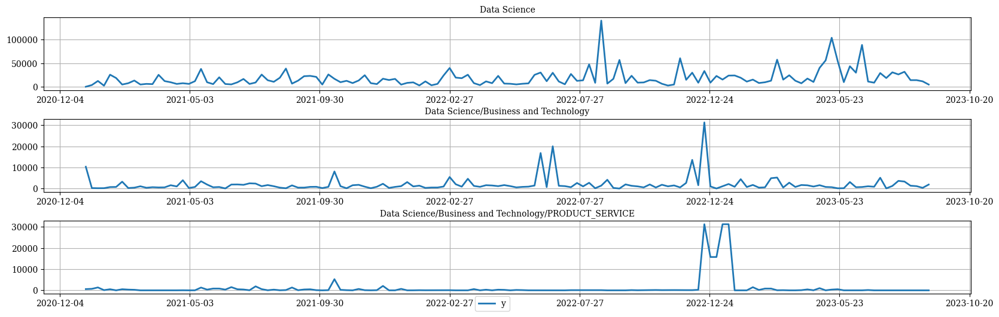

...

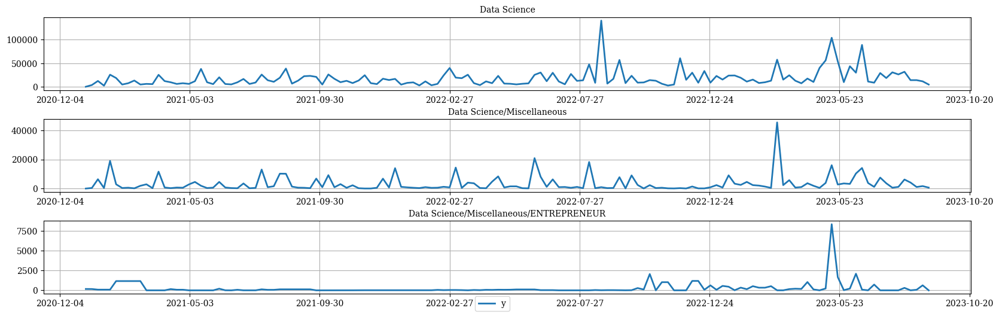

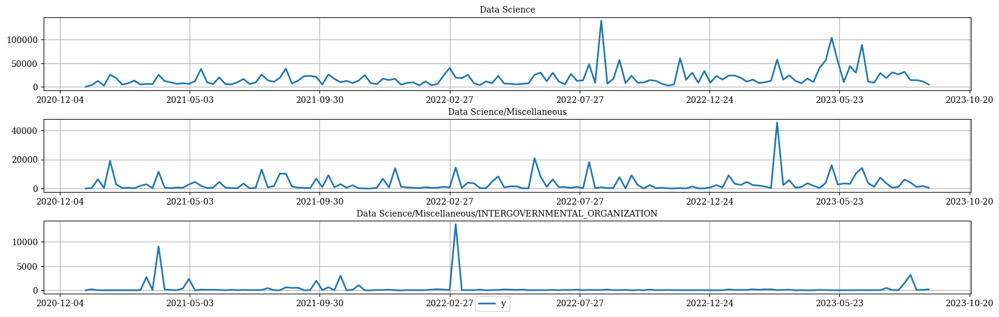

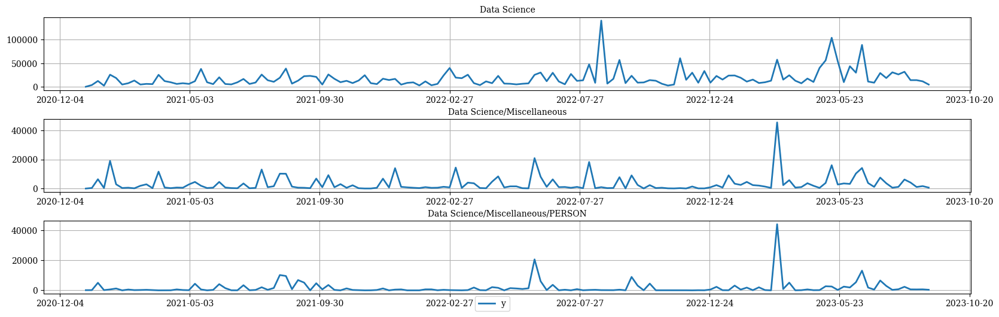

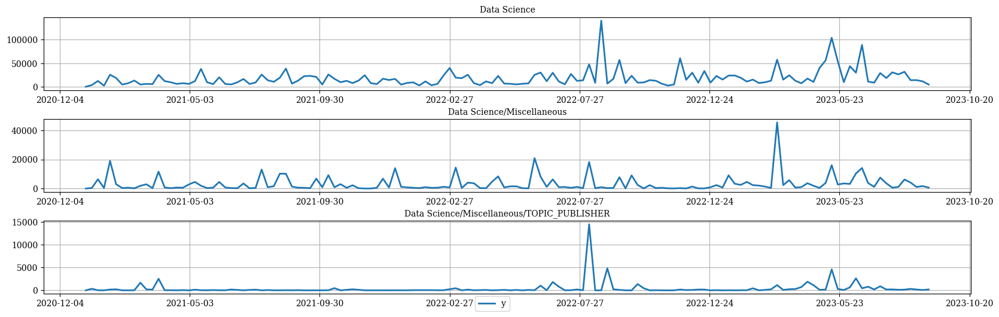

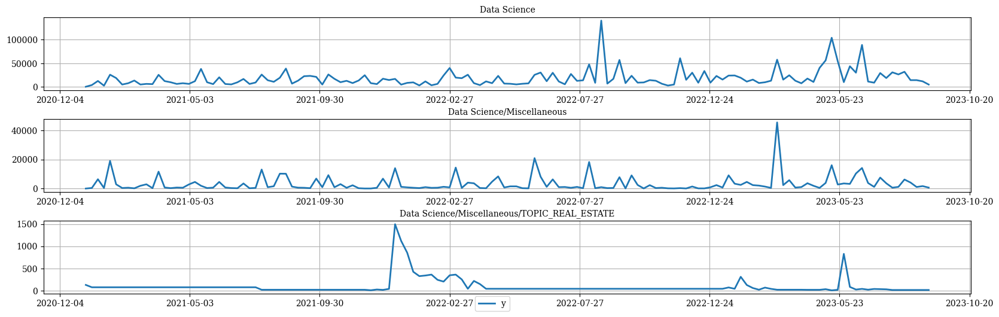

In [23]:
# Plot hierarchically linked series for each bottom series in 'tags'
for bottom_series_ in tags['Topic/Cluster/Category']:
    hplot.plot_hierarchically_linked_series(
        bottom_series=bottom_series_,
        Y_df=Y_df.set_index('unique_id')
    )

### Top Level - Data Science

Next, an examination of the time series decomposition components for the top-level time series corresponding to the Topic Level reveals the presence of both yearly seasonality and an upward trend within the time series.

The yearly seasonality suggests that there are recurring patterns or trends within the domain of data science that manifest on an annual basis. This could be linked to events such as conferences, academic semesters, or industry trends that consistently influence the field.

Simultaneously, the upward trend indicates a growing interest or engagement with data science over time. This could reflect an increasing demand for data-related skills and expertise, potentially driven by the expanding applications of data science in various industries and the recognition of its importance.

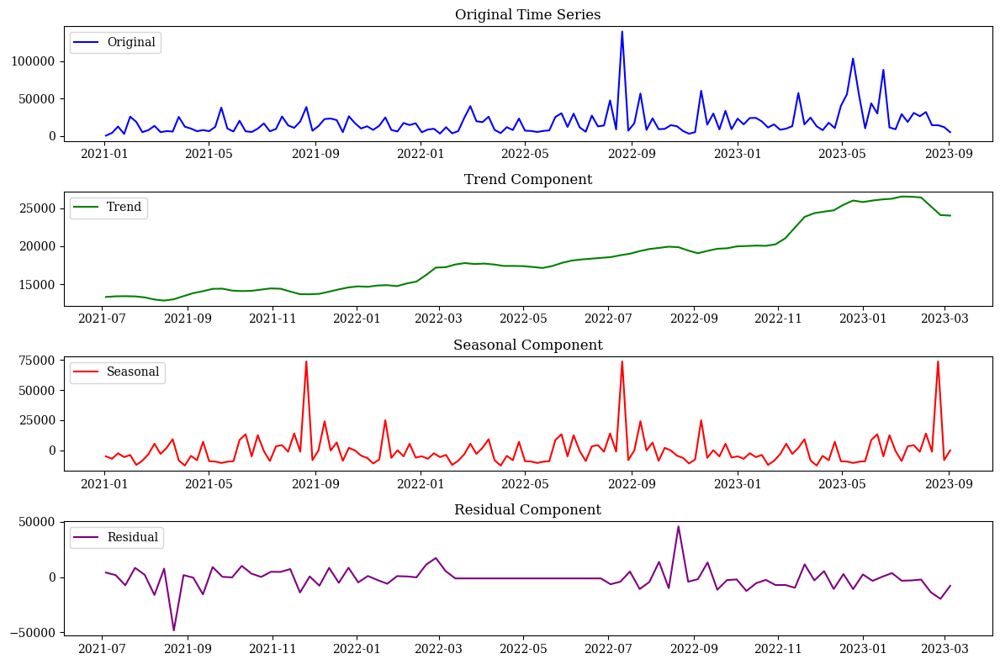

In [24]:
ts_top = Y_df.loc[Y_df['unique_id'] == 'Data Science'].set_index('ds')['y']

result = seasonal_decompose(ts_top, model='additive')

# Access the decomposed components
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# Create a figure with subplots
plt.figure(figsize=(12, 8))

# Plot the original time series
plt.subplot(411)
plt.plot(ts_top, label='Original', color='blue')
plt.legend(loc='upper left')
plt.title('Original Time Series')

# Plot the trend component
plt.subplot(412)
plt.plot(trend, label='Trend', color='green')
plt.legend(loc='upper left')
plt.title('Trend Component')

# Plot the seasonal component
plt.subplot(413)
plt.plot(seasonal, label='Seasonal', color='red')
plt.legend(loc='upper left')
plt.title('Seasonal Component')

# Plot the residual component
plt.subplot(414)
plt.plot(residual, label='Residual', color='purple')
plt.legend(loc='upper left')
plt.title('Residual Component')

# Add space between subplots
plt.tight_layout()

# Show the plot
plt.show()

### Mid Level - Business and Technology

Within `Data Science/Business and Technology`, the presence of yearly seasonality suggests that there are recurring patterns in user interactions and engagement. This could align with key industry events or product releases, resulting in spikes of engagement during specific times of the year.

The upward trend indicates a growing and sustained interest in the intersection of data science, business, and technology, likely driven by the increasing importance of data-driven decision-making in these sectors.

The combination of seasonality and an upward trend signifies a dynamic landscape where businesses and technology-driven entities consistently engage their audience while also experiencing long-term growth in their online interactions.

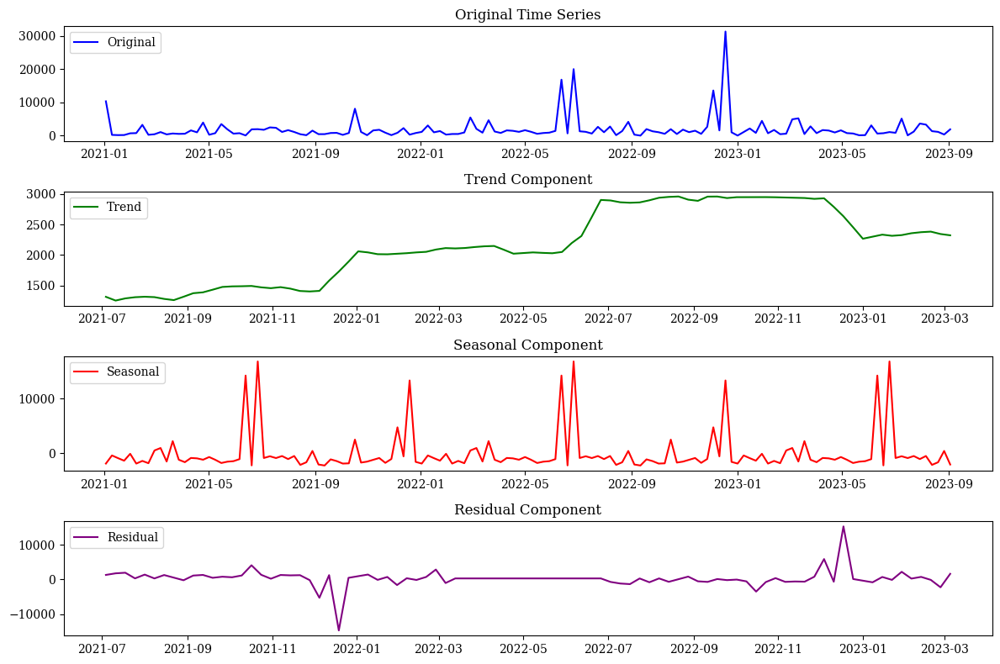

In [25]:
ts_mid_biz = Y_df.loc[Y_df['unique_id'] == 'Data Science/Business and Technology'].set_index('ds')['y']

result = seasonal_decompose(ts_mid_biz, model='additive')

# Access the decomposed components
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# Create a figure with subplots
plt.figure(figsize=(12, 8))

# Plot the original time series
plt.subplot(411)
plt.plot(ts_mid_biz, label='Original', color='blue')
plt.legend(loc='upper left')
plt.title('Original Time Series')

# Plot the trend component
plt.subplot(412)
plt.plot(trend, label='Trend', color='green')
plt.legend(loc='upper left')
plt.title('Trend Component')

# Plot the seasonal component
plt.subplot(413)
plt.plot(seasonal, label='Seasonal', color='red')
plt.legend(loc='upper left')
plt.title('Seasonal Component')

# Plot the residual component
plt.subplot(414)
plt.plot(residual, label='Residual', color='purple')
plt.legend(loc='upper left')
plt.title('Residual Component')

# Add space between subplots
plt.tight_layout()

# Show the plot
plt.show()

### Mid Level - Government and Organizations

In `Data Science/Government and Organizations`, the yearly seasonality reflects the cyclical nature of engagement, which could be influenced by governmental fiscal cycles, policy announcements, or public initiatives that garner increased attention during specific times of the year. The initial growth followed by stagnation suggests that while there was an enthusiastic start, the engagement levels might have encountered challenges or limitations in subsequent years, possibly due to shifting priorities or the need for ongoing strategies to maintain and elevate engagement within the governmental and organizational contexts.

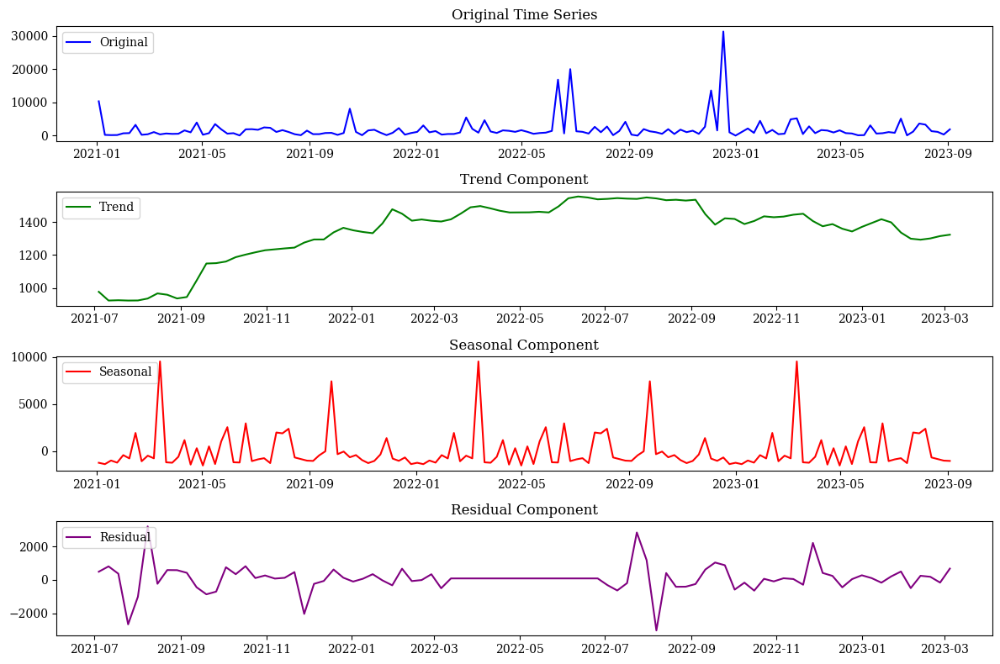

In [26]:
ts_mid_gov = Y_df.loc[Y_df['unique_id'] == 'Data Science/Government and Organizations'].set_index('ds')['y']

# Assuming ts_top is your time series
result = seasonal_decompose(ts_mid_gov, model='additive')

# Access the decomposed components
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# Create a figure with subplots
plt.figure(figsize=(12, 8))

# Plot the original time series
plt.subplot(411)
plt.plot(ts_mid_biz, label='Original', color='blue')
plt.legend(loc='upper left')
plt.title('Original Time Series')

# Plot the trend component
plt.subplot(412)
plt.plot(trend, label='Trend', color='green')
plt.legend(loc='upper left')
plt.title('Trend Component')

# Plot the seasonal component
plt.subplot(413)
plt.plot(seasonal, label='Seasonal', color='red')
plt.legend(loc='upper left')
plt.title('Seasonal Component')

# Plot the residual component
plt.subplot(414)
plt.plot(residual, label='Residual', color='purple')
plt.legend(loc='upper left')
plt.title('Residual Component')

# Add space between subplots
plt.tight_layout()

# Show the plot
plt.show()

### Mid Level - Education and Learning

The initial decline in engagement of `Education and Learning` from July 2021 to January 2022 could be attributed to seasonal variations, possibly related to academic schedules or holidays, affecting the frequency of online interactions within the education and learning sector.

Subsequent stabilization suggests a level of consistency in engagement during that period, but it's noteworthy that engagement levels began to surge from September 2022 onwards. This increase in engagement, particularly after the release of ChatGPT in November 2022, indicates a significant event or development that sparked heightened interest and interaction. It implies that innovations or noteworthy advancements in the field of data science can have a substantial impact on engagement within the education and learning sector.

Furthermore, the presence of yearly seasonality aligns with academic calendars, with peaks in engagement likely corresponding to the start of new academic years or semesters.

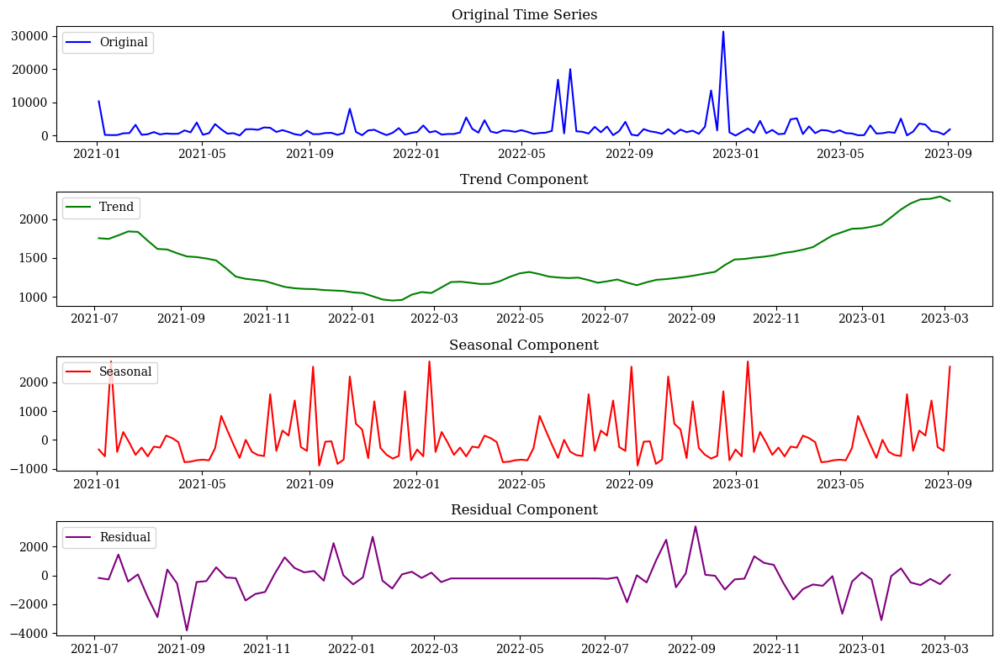

In [27]:
ts_mid_educ = Y_df.loc[Y_df['unique_id'] == 'Data Science/Education and Learning'].set_index('ds')['y']

# Assuming ts_top is your time series
result = seasonal_decompose(ts_mid_educ, model='additive')

# Access the decomposed components
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# Create a figure with subplots
plt.figure(figsize=(12, 8))

# Plot the original time series
plt.subplot(411)
plt.plot(ts_mid_biz, label='Original', color='blue')
plt.legend(loc='upper left')
plt.title('Original Time Series')

# Plot the trend component
plt.subplot(412)
plt.plot(trend, label='Trend', color='green')
plt.legend(loc='upper left')
plt.title('Trend Component')

# Plot the seasonal component
plt.subplot(413)
plt.plot(seasonal, label='Seasonal', color='red')
plt.legend(loc='upper left')
plt.title('Seasonal Component')

# Plot the residual component
plt.subplot(414)
plt.plot(residual, label='Residual', color='purple')
plt.legend(loc='upper left')
plt.title('Residual Component')

# Add space between subplots
plt.tight_layout()

# Show the plot
plt.show()

# Forecasting

## Split Train/Test sets

Next, we transition to the forecasting phase of this notebook. Initially, the dataset needs to be partitioned into training and test sets. In this context, the test set is designated to encompass the forecasting horizon, which is set at 12. The choice of 12 as the forecasting horizon is aligned with the common practice in marketing and business forecasting, where trends and patterns are often assessed quarterly. In this case, 12 weeks correspond to a quarter, providing us with a suitable timeframe to analyze the data science trend over the next quarter, a period commonly used for marketing and business planning purposes.

In [28]:
# Train-test split
Y_test_df = Y_df.groupby('unique_id').tail(12)
Y_train_df = Y_df.drop(Y_test_df.index)
Y_test_df

,unique_id,ds,y
128,Data Science,2023-06-18,88405.0
129,Data Science,2023-06-25,11327.0
130,Data Science,2023-07-02,8898.0
131,Data Science,2023-07-09,29188.0
132,Data Science,2023-07-16,18709.0
...,...,...,...
6575,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-06,13.0
6576,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-13,13.0
6577,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-20,13.0
6578,Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-27,13.0


In [29]:
Y_test_df = Y_test_df.set_index('unique_id')
Y_train_df = Y_train_df.set_index('unique_id')

In [30]:
Y_train_df.groupby('unique_id').size()

unique_id
Data Science                                                            128
Data Science/Business and Technology                                    128
Data Science/Business and Technology/COMPUTER_COMPANY                   128
Data Science/Business and Technology/CONSULTING_COMPANY                 128
Data Science/Business and Technology/FINANCIAL_SERVICES                 128
Data Science/Business and Technology/INFORMATION_TECHNOLOGY_COMPANY     128
Data Science/Business and Technology/PRODUCT_SERVICE                    128
Data Science/Business and Technology/RECRUITER                          128
Data Science/Business and Technology/SCIENCE_ENGINEERING                128
Data Science/Business and Technology/SCIENCE_SITE                       128
Data Science/Business and Technology/SOFTWARE_COMPANY                   128
Data Science/Business and Technology/TOPIC_BUSINESS_SERVICES            128
Data Science/Community and Non-Profit                                   128
Da

## Cross-validation

Next, in the cross-validation phase, the objective is to assess the performance of the AutoARIMA model, Auto Exponential Smoothing Model, and Naive model for each hierarchical structure. These automated models are specifically chosen for their advantages over their non-automatic counterparts. They possess the capability to automatically identify optimal parameters, offering a data-driven approach to forecasting. This ensures that the models adapt effectively to the inherent patterns and complexities present in the data, resulting in more accurate predictions compared to non-automatic versions, which often rely on manually specified parameters that may not capture the full dynamics of the data.

These are the models that were utilized:

**`AutoARIMA (Auto-Regressive Integrated Moving Average)`**

- AutoARIMA is a versatile and widely used time series forecasting model.
- It operates based on the principles of ARIMA, which stands for Auto-Regressive Integrated Moving Average.
- AutoARIMA automatically selects the optimal values for the three main components of ARIMA: p (Auto-Regressive), d (Integrated), and q (Moving Average).
- The "season_length" parameter is used to specify the seasonality of the time series, which is important for capturing recurring patterns in the data.
- The model explores different combinations of p, d, and q values and selects the one that minimizes a chosen criterion (e.g., AIC or BIC).
- It can handle both non-seasonal and seasonal time series data, making it suitable for a wide range of forecasting tasks. [9]

**`AutoETS (Exponential Smoothing)`**

- AutoETS is another automatic forecasting model designed for time series data.
- It's based on Exponential Smoothing, which is a family of forecasting methods that assigns exponentially decreasing weights to past observations.
- Similar to AutoARIMA, AutoETS automatically selects the best parameters for the exponential smoothing model, such as the type of exponential smoothing (e.g., additive or multiplicative) and the smoothing parameters (alpha, beta, gamma).
- The "season_length" parameter is used to define the seasonality of the time series.
- AutoETS is particularly useful when dealing with time series data that exhibit different levels of seasonality and trend components. [9, 10]

**`Naive Model`**

- The Naive model is one of the simplest forecasting methods.
- It makes predictions by assuming that future values of the time series will be the same as the most recent observed value.
- In other words, it assumes no trend, seasonality, or other patterns in the data.
- The Naive model can be useful as a baseline or benchmark model to compare the performance of more complex forecasting methods.
- It is often used when there is no evidence of systematic patterns in the time series data or when other models are not applicable.

The cross-validation strategy employs an expanding window cross-validation [6] approach with 10 folds. Within each fold, the training set progressively expands, while the validation period spans 12 weeks and shifts by 1 week with each fold. This approach allows for a robust evaluation of the model's performance across different time periods and ensures that the forecasting models are tested comprehensively against the available data.

In [2]:
horizon=12
fcst = StatsForecast(df=Y_df, 
                     models=[AutoARIMA(season_length=5, #SARIMA
                                       seasonal=True), 
                             AutoETS(season_length=5), #ETS
                             Naive()], 
                     freq='W',
                     n_jobs=-1)

Y_hat_df = fcst.cross_validation(df=Y_df,
                                 h=horizon,
                                 n_windows=None,
                                 step_size= 2,
                                 test_size=12,
                                 fitted=True
)
Y_fitted_df = fcst.cross_validation_fitted_values()

NameError: name 'StatsForecast' is not defined

In [32]:
Y_hat_df

,ds,cutoff,y,AutoARIMA,AutoETS,Naive
unique_id,,,,,,
Data Science,2023-06-18,2023-06-11,88405.0,30516.675781,32074.275391,29992.0
Data Science,2023-06-25,2023-06-11,11327.0,30516.675781,28556.363281,29992.0
Data Science,2023-07-02,2023-06-11,8898.0,30516.675781,37956.179688,29992.0
Data Science,2023-07-09,2023-06-11,29188.0,30516.675781,18882.085938,29992.0
Data Science,2023-07-16,2023-06-11,18709.0,30516.675781,23404.212891,29992.0
...,...,...,...,...,...,...
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-06,2023-06-11,13.0,1.005656,113.676857,23.0
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-13,2023-06-11,13.0,0.680048,113.676857,23.0
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-08-20,2023-06-11,13.0,0.459865,113.676857,23.0


In [33]:
Y_fitted_df

,ds,cutoff,y,AutoARIMA,AutoETS,Naive
unique_id,,,,,,
Data Science,2021-01-03,2023-06-11,417.0,416.583008,11680.080078,NaN
Data Science,2021-01-10,2023-06-11,3969.0,1356.961182,5872.443848,417.0
Data Science,2021-01-17,2023-06-11,12556.0,3771.181152,7363.851562,3969.0
Data Science,2021-01-24,2023-06-11,2656.0,5382.062500,10488.369141,12556.0
Data Science,2021-01-31,2023-06-11,25769.0,6433.537109,9439.328125,2656.0
...,...,...,...,...,...,...
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-05-14,2023-06-11,5.0,20.962927,25.467808,31.0
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-05-21,2023-06-11,17.0,3.381117,13.172842,5.0
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-05-28,2023-06-11,827.0,11.495798,15.471802,17.0


## Reconciliation

Next, the objective is to ensure the coherence of the forecasts through a reconciliation process. This process involves the application of two distinct approaches: BottomUp and MinTrace (utilizing the 'ols' method).

**`BottomUp Reconciliation`**

- The BottomUp reconciliation method is a straightforward approach to combine forecasts in a hierarchical structure.
- In this method, forecasts are initially generated at the lowest level of the hierarchy, which corresponds to individual time series or categories.
- These forecasts are then aggregated or summed up to obtain forecasts at higher levels of the hierarchy.
- The process continues, moving up the hierarchy until forecasts are obtained at the top-level, which represents the aggregate or total forecast for the entire dataset.
- BottomUp reconciliation is intuitive and easy to implement, making it a practical choice when simplicity is a priority.
- However, it may not capture complex interdependencies and correlations between different levels of the hierarchy. [7]


**`MinTrace Reconciliation with 'OLS' Method`**

- The MinTrace reconciliation method is a more sophisticated approach that aims to find the reconciliation matrix that minimizes the trace of the error covariance matrix.
- In other words, it seeks to minimize the discrepancy between the reconciled forecasts and the actual values.
- The 'OLS' method stands for Ordinary Least Squares and is one of the techniques used to estimate the reconciliation matrix.
- The reconciliation matrix is essentially a set of coefficients that determine how forecasts at lower levels are combined to generate forecasts at higher levels while minimizing the overall forecast error.
- MinTrace reconciliation takes into account the correlations and dependencies between time series at different levels of the hierarchy, providing a more accurate and coherent reconciliation of forecasts.
- This method is particularly useful when there are complex relationships and dependencies between hierarchical levels, making it suitable for datasets with intricate structures. [8]

Additionally, the objective of acquiring bootstrapped errors in the context of hierarchical time series forecasting is to enhance the robustness and reliability of the forecast evaluation process. The rationale behind performing bootstrapped errors is to obtain prediction intervals based on the distribution of the observations rather than relying on traditional confidence levels. Bootstrapping allows us to construct intervals by repeatedly resampling the data and generating a distribution of forecast errors. This approach is particularly advantageous because it captures the inherent variability and potential outliers in the data, offering a more realistic representation of uncertainty in the forecasts. [11, 12]

In [34]:
reconcilers = [
    BottomUp(),
    MinTrace(method='ols')
]

hrec = HierarchicalReconciliation(reconcilers=reconcilers)
Y_rec_df = hrec.reconcile(Y_hat_df=Y_hat_df, Y_df=Y_fitted_df, 
                          S=S_df, tags=tags, level=[90],
                          intervals_method='bootstrap')

In [35]:
for i_ in Y_rec_df[2:]:
    print(i_)

ds
cutoff
y
AutoARIMA
AutoETS
Naive
cutoff/BottomUp
cutoff/BottomUp-lo-90
cutoff/BottomUp-hi-90
AutoARIMA/BottomUp
AutoARIMA/BottomUp-lo-90
AutoARIMA/BottomUp-hi-90
AutoETS/BottomUp
AutoETS/BottomUp-lo-90
AutoETS/BottomUp-hi-90
Naive/BottomUp
Naive/BottomUp-lo-90
Naive/BottomUp-hi-90
cutoff/MinTrace_method-ols
cutoff/MinTrace_method-ols-lo-90
cutoff/MinTrace_method-ols-hi-90
AutoARIMA/MinTrace_method-ols
AutoARIMA/MinTrace_method-ols-lo-90
AutoARIMA/MinTrace_method-ols-hi-90
AutoETS/MinTrace_method-ols
AutoETS/MinTrace_method-ols-lo-90
AutoETS/MinTrace_method-ols-hi-90
Naive/MinTrace_method-ols
Naive/MinTrace_method-ols-lo-90
Naive/MinTrace_method-ols-hi-90


## Evaluation

In [36]:
cols = ['ds', 'AutoARIMA/BottomUp', 'AutoARIMA/MinTrace_method-ols',
        'AutoETS/BottomUp', 'AutoETS/MinTrace_method-ols',
        'Naive/BottomUp', 'Naive/MinTrace_method-ols']

eval_tags = {}
eval_tags['Topic'] = tags['Topic']
eval_tags['Cluster'] = tags['Topic/Cluster']
eval_tags['Category'] = tags['Topic/Cluster/Category']
eval_tags['All'] = np.concatenate(list(tags.values()))

evaluator = HierarchicalEvaluation(evaluators=[mae, mase, rmse, mape])
evaluation = evaluator.evaluate(Y_hat_df=Y_rec_df[cols],
                                Y_test_df=Y_rec_df[['ds', 'y']],
                                Y_df=Y_train_df,
                                tags=eval_tags
)
evaluation = evaluation.drop('Overall')
# # evaluation.columns = ['Base', 'BottomUp', 'MinTrace(mint_shrink)', 'MinTrace(ols)',
# #                       'Base', 'BottomUp', 'MinTrace(mint_shrink)', 'MinTrace(ols)']
evaluation = evaluation.applymap('{:.2f}'.format)

/tmp/ipykernel_18446/2910927211.py:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  evaluation = evaluation.drop('Overall')


### Scores

After a thorough assessment of model performance and reconciliation methods across various hierarchical levels, a clear pattern emerges, favoring the AutoARIMA model in combination with the BottomUp reconciliation method as the optimal choice. These findings hold true consistently across all levels of hierarchy within the dataset.

The compelling evidence for this preference lies in the performance metrics, where the AutoARIMA/BottomUp pairing consistently outshines the alternatives. Of particular note is the `Mean Absolute Scaled Error (MASE)` metric, which serves as a significant benchmark. A MASE score below 1.0 signifies an improved forecast accuracy compared to a simple naive forecast without reconciliation. Conversely, scores exceeding 1.0 indicate less accurate forecasts. [13, 14]

In [37]:
evaluation

AutoARIMA/BottomUp AutoARIMA/MinTrace_method-ols  \
level    metric                                                    
Topic    mae              12304.00                      15407.45   
         mase                 0.86                          1.08   
         rmse             18514.02                      21607.96   
         mape                68.96                        112.94   
Cluster  mae               2694.16                       3582.99   
         mase                 0.72                          0.93   
         rmse              4118.26                       4768.91   
         mape               185.03                        318.20   
Category mae                762.76                        876.15   
         mase                 0.88                          1.38   
         rmse              1270.26                       1345.94   
         mape              2166.72                       3857.21   
All      mae               1254.88                       1530.88   
         mase                 0.86                          1.32   
         rmse              2000.73                       2214.02   
         mape              1869.10                       3325.76   

                AutoETS/BottomUp AutoETS/MinTrace_method-ols Naive/BottomUp  \
level    metric                                                               
Topic    mae            24322.59                    16005.37       16305.67   
         mase               1.70                        1.12           1.14   
         rmse           27453.89                    21881.04       22192.58   
         mape             195.53                      119.80         123.16   
Cluster  mae             4824.06                     3578.61        3982.37   
         mase               1.13                        0.86           1.03   
         rmse            5625.70                     4852.78        5393.94   
         mape             443.91                      305.28         315.35   
Category mae             1116.32                     1045.54         975.44   
         mase               1.36                        1.78           1.25   
         rmse            1661.67                     1640.43        1473.88   
         mape            4545.29                     4536.07        2296.35   
All      mae             2083.40                     1687.20        1685.48   
         mase               1.34                        1.65           1.22   
         rmse            2716.49                     2481.17        2415.13   
         mape            3929.16                     3902.01        1997.22   

                Naive/MinTrace_method-ols  
level    metric                            
Topic    mae                     15948.11  
         mase                        1.12  
         rmse                    21994.08  
         mape                      119.13  
Cluster  mae                      3920.40  
         mase                        0.96  
         rmse                     5328.23  
         mape                      251.96  
Category mae                       977.50  
         mase                        1.35  
         rmse                     1476.13  
         mape                     2324.74  
All      mae                      1671.71  
         mase                        1.30  
         rmse                     2404.44  
         mape                     2013.20

# Plot Forecasts

Moving forward, our objective is to create visual representations of our forecasts, generated using the most effective model and reconciliation method, in conjunction with the actual observed values. This visual assessment promises to unveil the degree of alignment between our forecasts and the real data, shedding light on the accuracy and reliability of our predictive models.

In [38]:
plot_df = pd.concat([Y_df.set_index(['unique_id', 'ds']), 
                     Y_rec_df.set_index('ds', append=True)], axis=1)
plot_df = plot_df.reset_index('ds')

## Plot single time series

### Topic Level

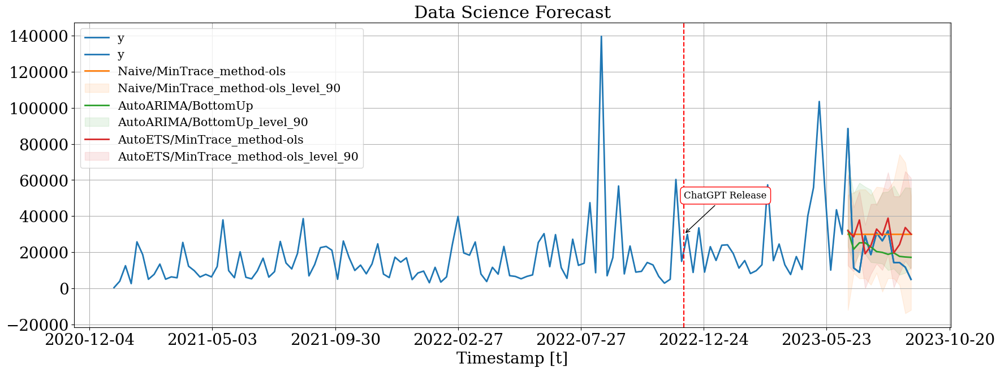

In [39]:
# Code for plotting the series and adding the vertical line
hplot.plot_series(
    series='Data Science',
    Y_df=plot_df, 
    models=['y', 'Naive/MinTrace_method-ols', 'AutoARIMA/BottomUp', 'AutoETS/MinTrace_method-ols'],
    level=[90]
)

vertical_line_date = pd.to_datetime('2022-11-30')
plt.axvline(x=vertical_line_date, color='red', linestyle='--', label='Vertical Line at Nov 30, 2022')

# Add text and an arrow pointing to the event
event_date = pd.to_datetime('2022-11-30')  # Date of the ChatGPT release
event_text = 'ChatGPT Release'  # Text to display
arrow_properties = dict(arrowstyle="->")

plt.annotate(event_text, xy=(event_date, 30000), xytext=(event_date, 50000),
             arrowprops=arrow_properties, fontsize=12,
             bbox=dict(boxstyle='round,pad=0.4', edgecolor='red', facecolor='white'))

# Show the plot
plt.show()

### Cluster Level

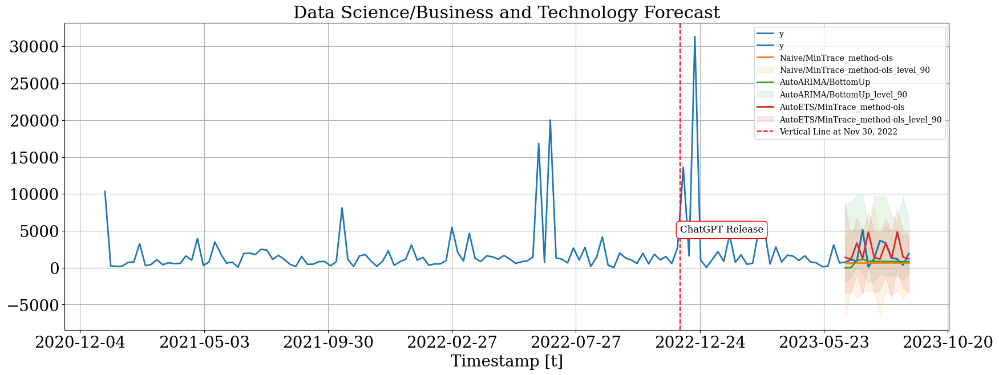

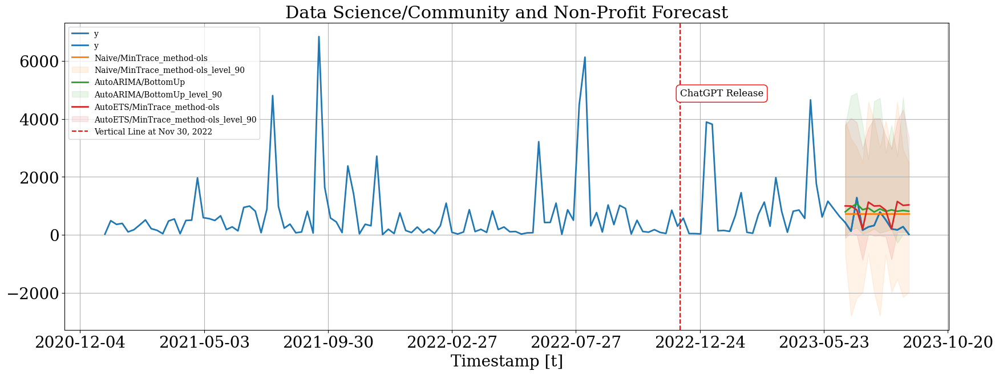

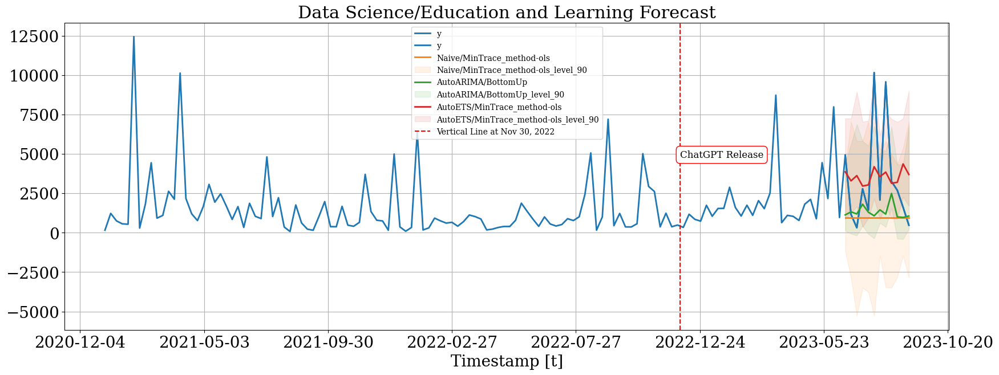

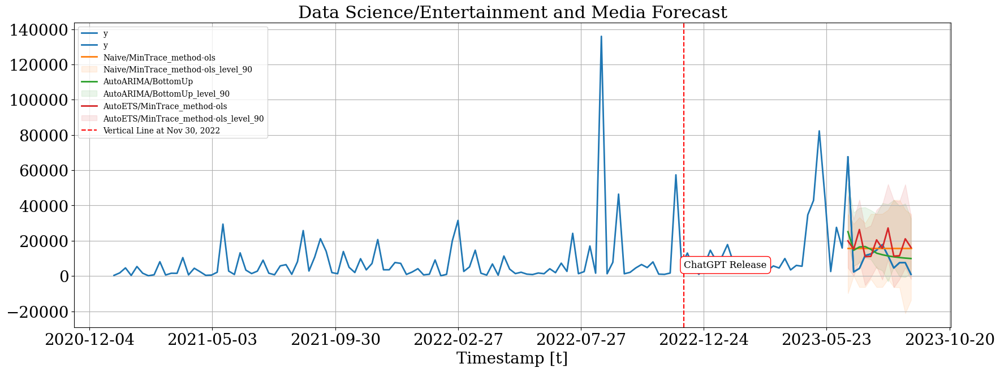

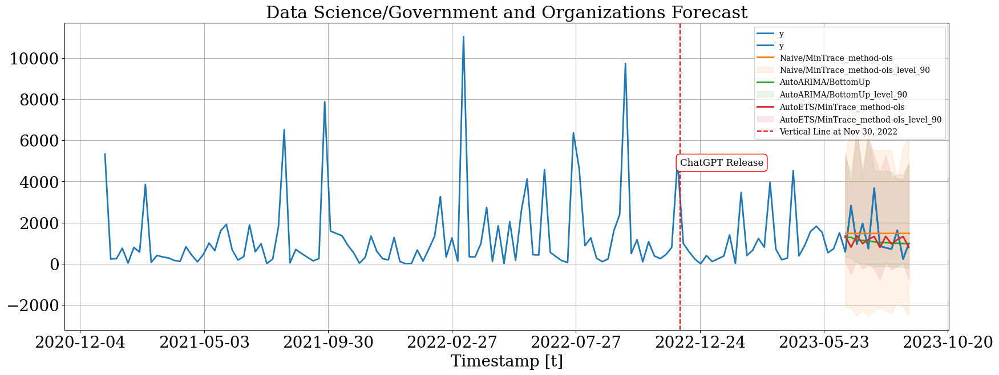

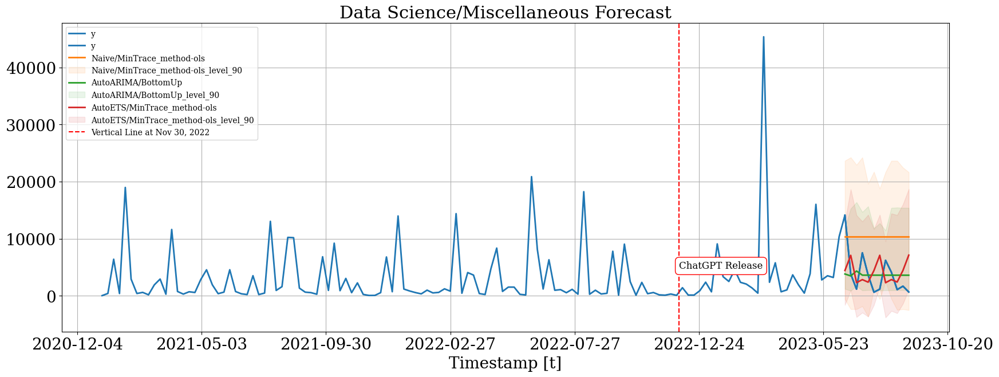

In [40]:
vertical_line_date = pd.to_datetime('2022-11-30')
event_date = pd.to_datetime('2022-11-30')  # Date of the ChatGPT release
event_text = 'ChatGPT Release'  # Text to display
arrow_properties = dict(arrowstyle="->")

for series_ in tags['Topic/Cluster']:
    # Code for plotting the series and adding the vertical line
    hplot.plot_series(
        series=series_,
        Y_df=plot_df, 
        models=['y', 'Naive/MinTrace_method-ols', 'AutoARIMA/BottomUp', 'AutoETS/MinTrace_method-ols'],
        level=[90]
    )
    
    plt.axvline(x=vertical_line_date, color='red', linestyle='--', label='Vertical Line at Nov 30, 2022')
    
    # Calculate the maximum value for the current series
    max_value = np.max(plot_df.loc[plot_df.index == 'Data Science/Community and Non-Profit']['y'])

    # Adjust the annotation position based on the maximum value
    annotation_y = max_value * 0.7  # You can adjust the offset (0.1) as needed
    
    # Add text and an arrow pointing to the event (inside the loop)
    plt.annotate(event_text, xy=(event_date, annotation_y), xytext=(event_date, annotation_y),
                 arrowprops=arrow_properties, fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.4', edgecolor='red', facecolor='white'))

    # Add a legend to the plot
    plt.legend()

    # Show the plots
    plt.show()

### Category Level

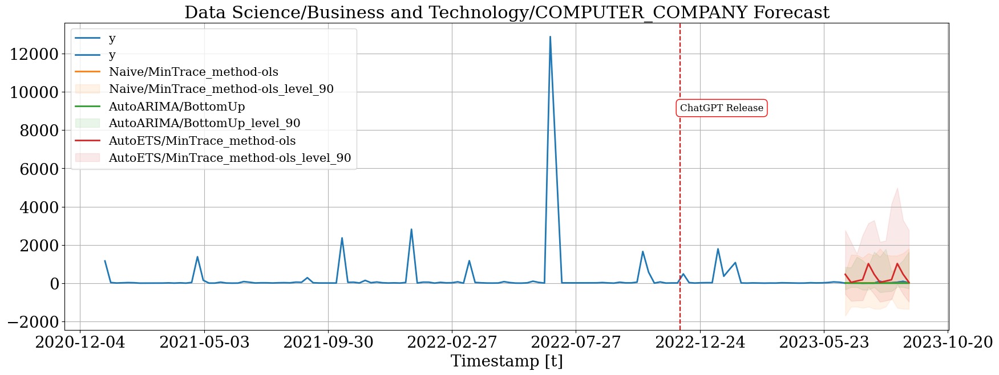

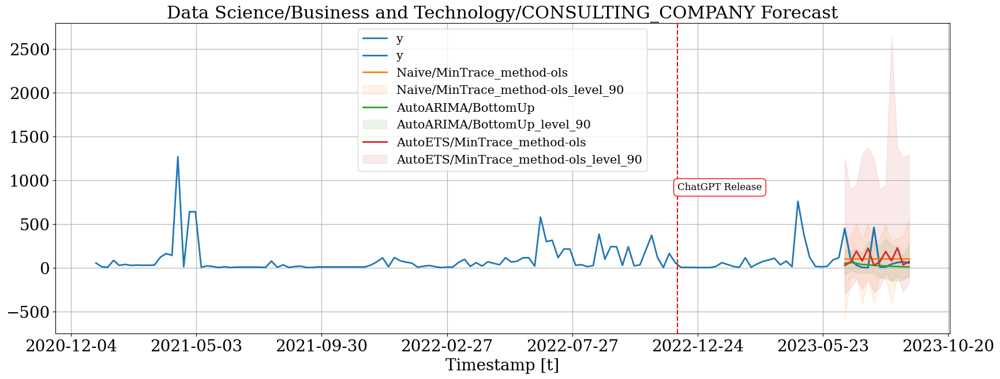

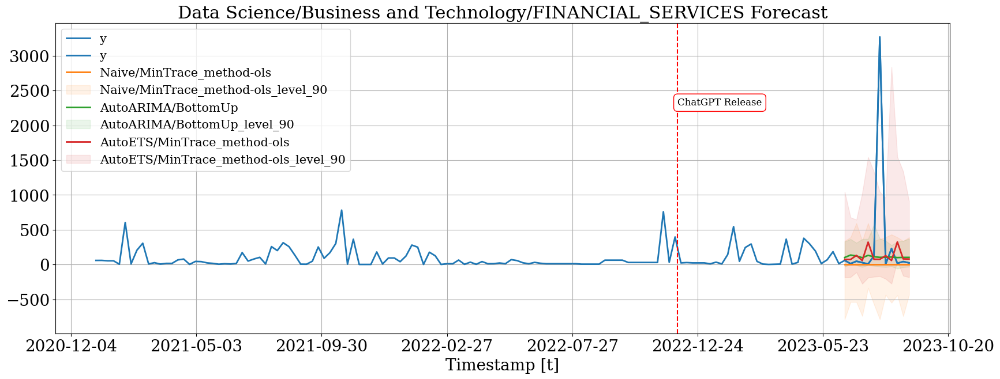

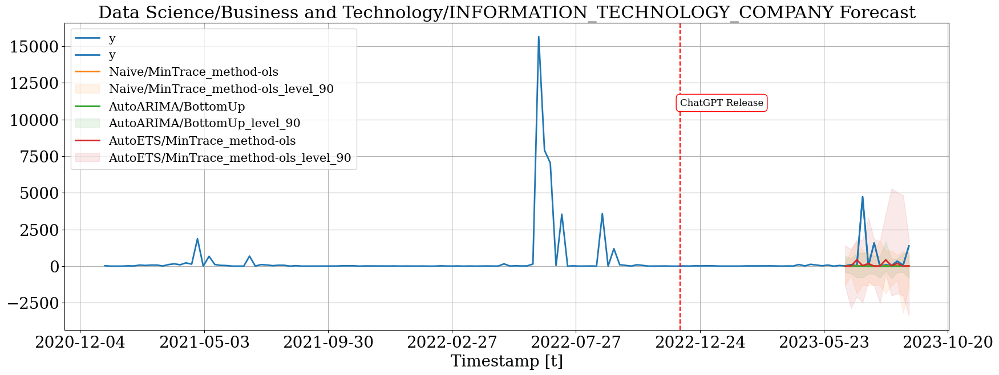

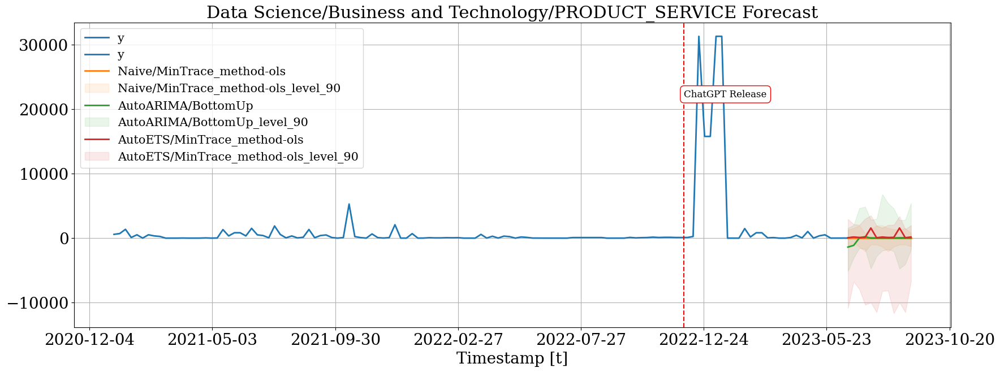

...

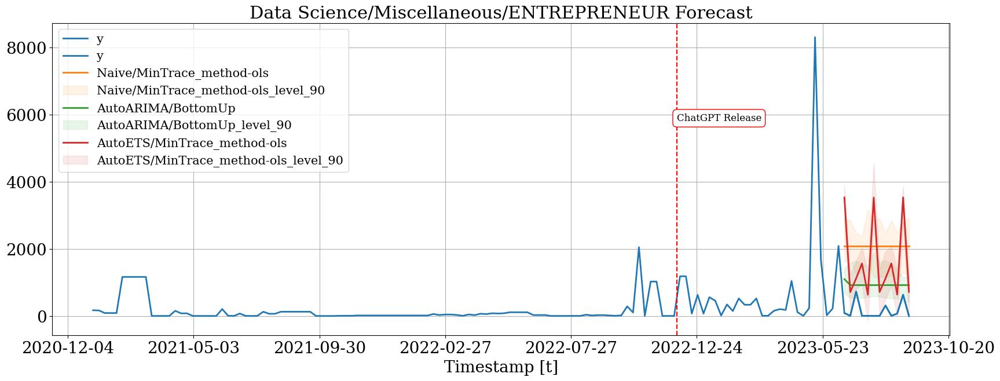

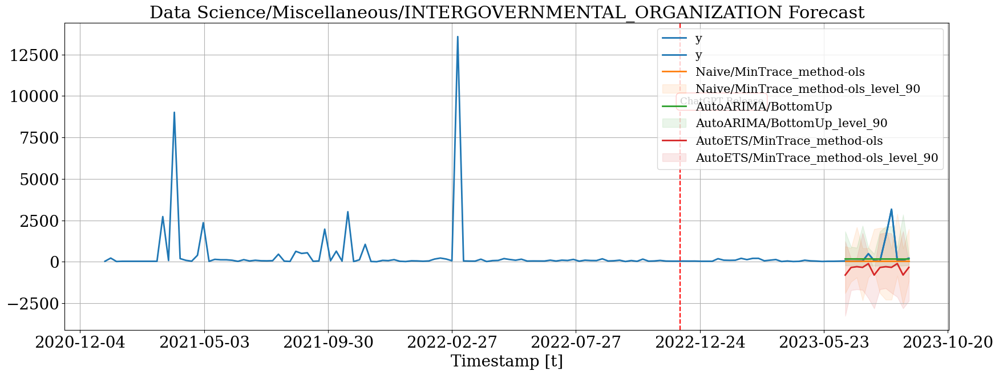

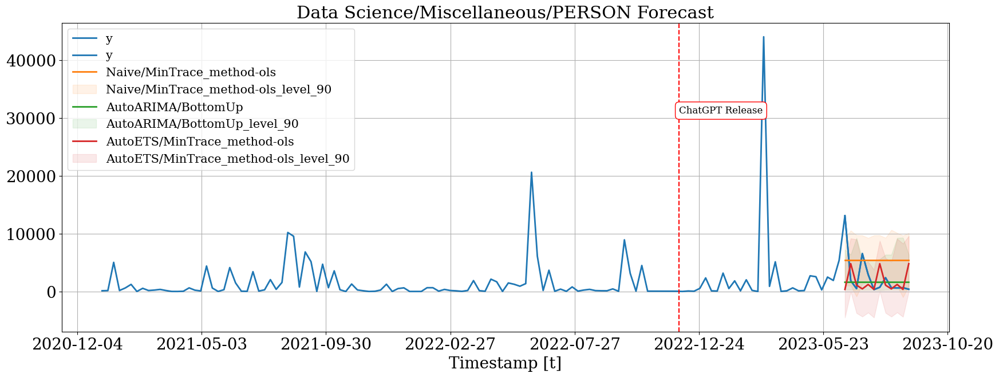

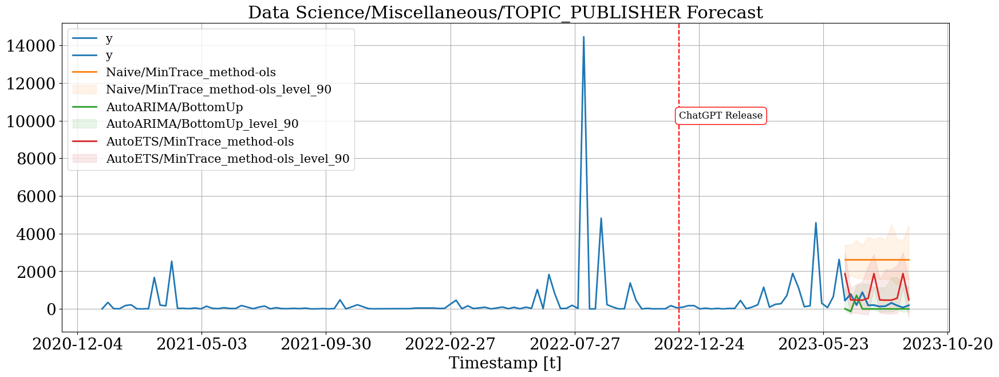

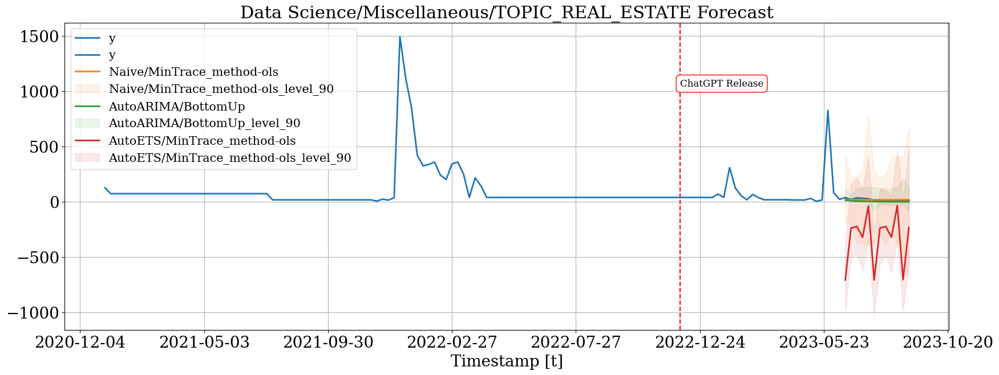

In [41]:
for series_ in tags['Topic/Cluster/Category']:
    hplot.plot_series(
        series=series_,
        Y_df=plot_df, 
        models=['y', 'Naive/MinTrace_method-ols', 'AutoARIMA/BottomUp', 'AutoETS/MinTrace_method-ols'],
        level=[90]
)
    
    plt.axvline(x=vertical_line_date, color='red', linestyle='--', label='Vertical Line at Nov 30, 2022')
    
    # Calculate the maximum value for the current series
    max_value = np.max(plot_df.loc[plot_df.index == series_]['y'])

    # Adjust the annotation position based on the maximum value
    annotation_y = (max_value * 0.7)  # You can adjust the offset (0.1) as needed
    
    # Add text and an arrow pointing to the event (inside the loop)
    plt.annotate(event_text, xy=(event_date, annotation_y), xytext=(event_date, annotation_y),
                 arrowprops=arrow_properties, fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.4', edgecolor='red', facecolor='white'))

    # Show the plots
    plt.show()

## Plot hierarchichally linked time series

/home/msds2023/byepes/.local/lib/python3.10/site-packages/hierarchicalforecast/utils.py:347: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(len(linked_series), 1, figsize=(20, 2 * len(linked_series)))


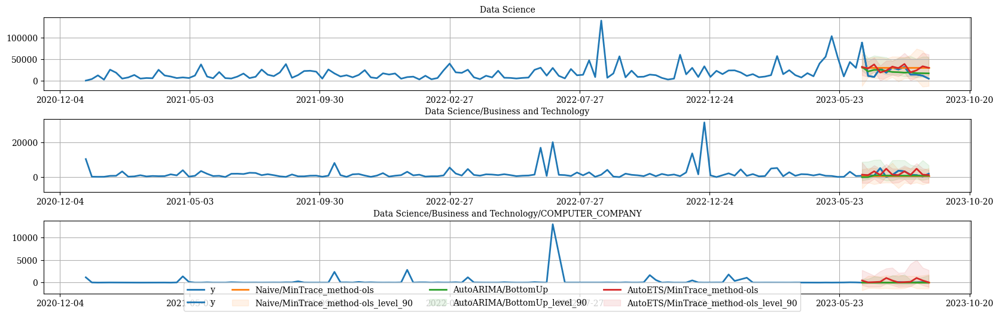

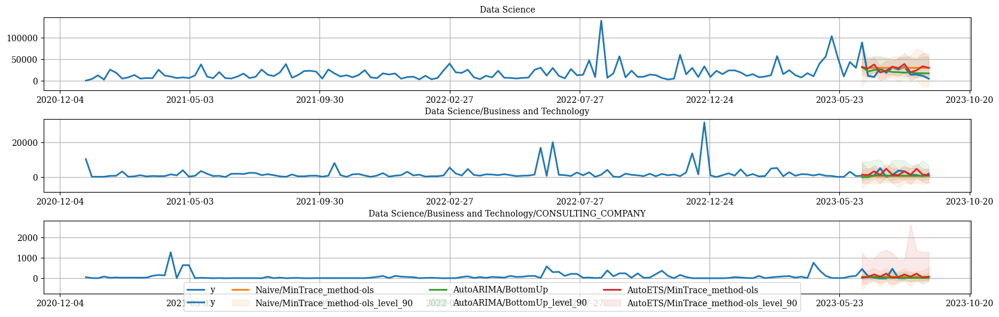

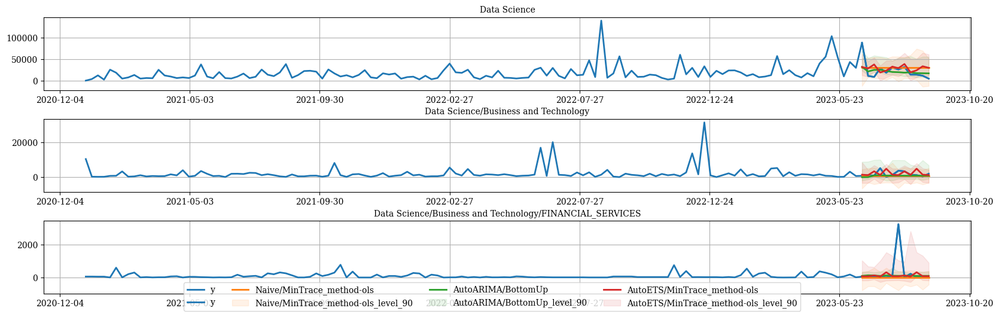

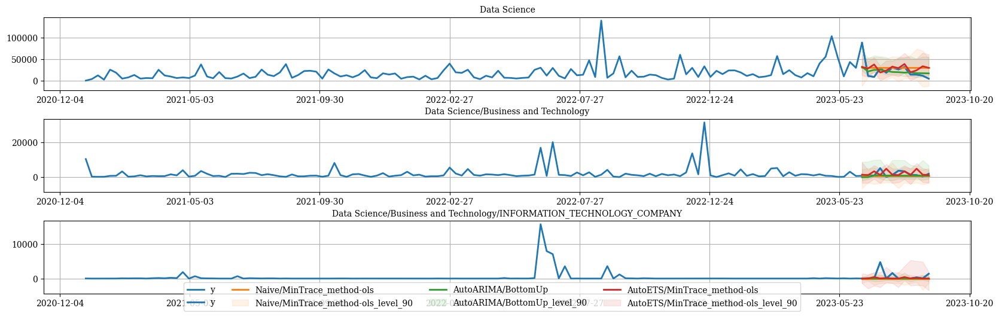

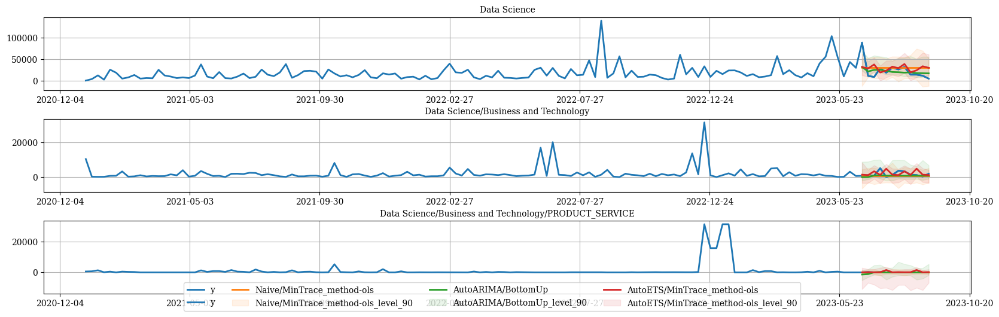

...

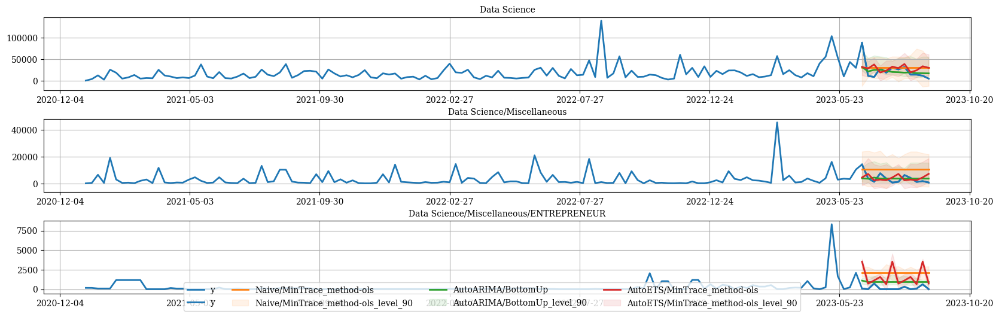

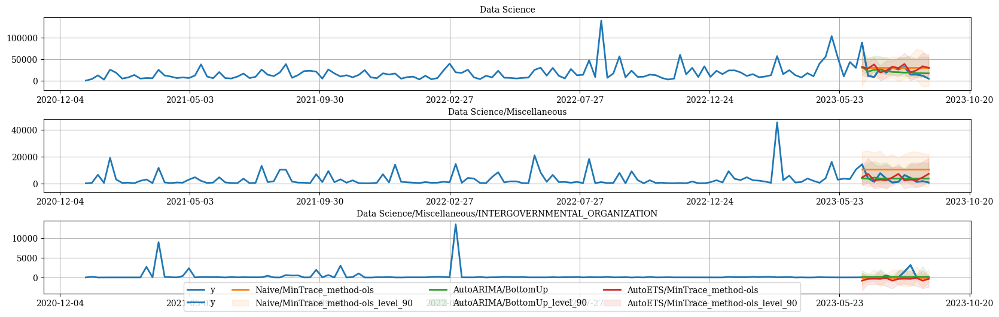

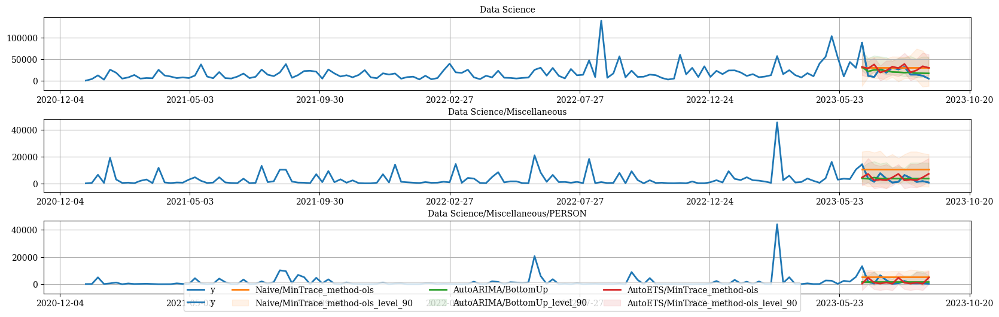

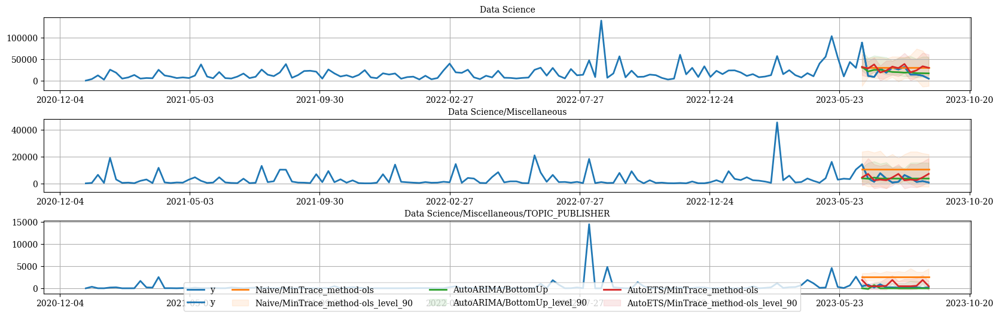

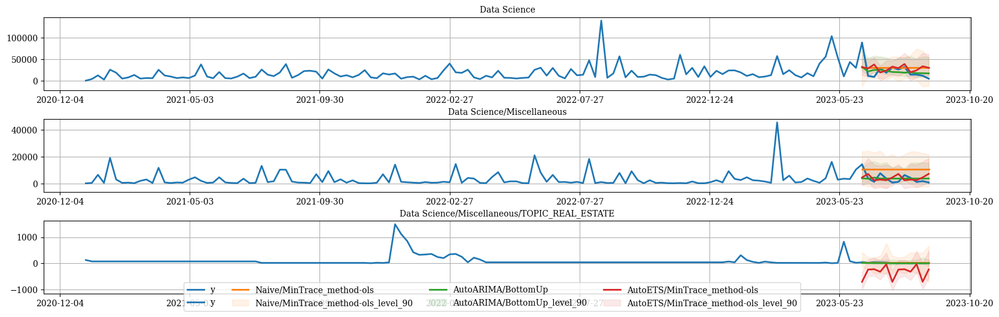

In [42]:
for series_ in tags['Topic/Cluster/Category']:
    hplot.plot_hierarchically_linked_series(
        bottom_series=series_,
        Y_df=plot_df, 
        models=['y', 'Naive/MinTrace_method-ols', 'AutoARIMA/BottomUp', 'AutoETS/MinTrace_method-ols'],
        level=[90]
    )

# ML Frameworks

Subsequently, the analysis transitions from utilizing statistical models to exploring the realm of machine learning (ML) models. This phase of the analysis involves harnessing the predictive potential inherent in ML algorithms to elevate the precision of forecasts.

## Dataset

In [43]:
def sort_hier_df(Y_df, S_df):
    # sorts unique_id lexicographically
    Y_df.unique_id = Y_df.unique_id.astype('category')
    Y_df.unique_id = Y_df.unique_id.cat.set_categories(S_df.index)
    Y_df = Y_df.sort_values(by=['unique_id', 'ds'])
    return Y_df

Y_df = sort_hier_df(Y_df, S_df)
     

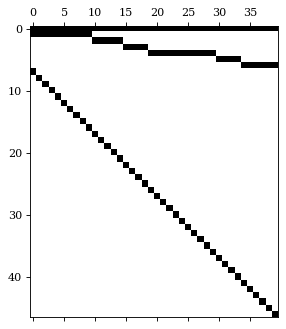

In [44]:
hplot = HierarchicalPlot(S=S_df, tags=tags)
hplot.plot_summing_matrix()

## Train-test split

In [45]:
horizon = 12
Y_test_df = Y_df.groupby('unique_id').tail(horizon)
Y_train_df = Y_df.drop(Y_test_df.index)

## Cross-validation

Subsequently, the analysis proceeds to cross-validation, applying the same expanding window cross-validation strategy [6] to assess the performance of two ML models: `XGBoost` and `HistGradientBoosting`. Although initial experiments included other models such as random forest, AdaBoost, and decision trees, it was observed that these models did not align well with the data's characteristics. Consequently, for the sake of expediting runtime and focusing on more promising approaches, only `XGBoost` and `HistGradientBoosting` have been retained within this section

In [46]:
level = np.arange(0, 100, 2)
qs = [[50-lv/2, 50+lv/2] for lv in level]
quantiles = np.sort(np.concatenate(qs)/100)
quantiles = np.sort(np.concatenate(qs)/100)
horizon=12

#fit/predict XGBRegressor from MLForecast
mf = MLForecast(models=[xgb.XGBRegressor(),
                        HistGradientBoostingRegressor(),
                        ], 
                freq='W',
                lags=[1,2,7,14],
                date_features=['week'],
                )
Y_hat_mf = mf.cross_validation(df=Y_df,
                               h=horizon,
                               n_windows=10,
                               step_size=1,
                               fitted=True,
                               prediction_intervals=PredictionIntervals(n_windows=5, window_size=horizon)
) 
Y_fitted_mf = mf.cross_validation_fitted_values()

Y_hat_mf = Y_hat_mf.set_index('unique_id')
Y_fitted_mf = Y_fitted_mf.set_index('unique_id')

/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/forecast.py:658: UserWarning: Excuting `cross_validation` after `fit` can produce unexpected errors
  warnings.warn(
/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/forecast.py:658: UserWarning: Excuting `cross_validation` after `fit` can produce unexpected errors
  warnings.warn(
/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/forecast.py:658: UserWarning: Excuting `cross_validation` after `fit` can produce unexpected errors
  warnings.warn(
/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/forecast.py:658: UserWarning: Excuting `cross_validation` after `fit` can produce unexpected errors
  warnings.warn(
/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/forecast.py:658: UserWarning: Excuting `cross_validation` after `fit` can produce unexpected errors
  warnings.warn(
/home/msds2023/byepes/.local/lib/python3.10/site-packages/mlforecast/f

In the following step, the same reconciliation grid is employed to evaluate the performance of both the `BottomUp` and `MinTrace(method='ols')` approaches. The objective of this evaluation is to ascertain which of these reconciliation methods produces a more coherent forecast.

In [47]:
reconcilers = [
    BottomUp(),
    MinTrace(method='ols')
]

hrec = HierarchicalReconciliation(reconcilers=reconcilers)

Y_rec_mf = hrec.reconcile(Y_hat_df=Y_hat_mf,
                          Y_df=Y_fitted_mf,
                          S=S_df,
                          tags=tags)

## Evaluation

In [48]:
cols = ['ds', 'XGBRegressor/BottomUp','XGBRegressor/MinTrace_method-ols',
        'HistGradientBoostingRegressor/BottomUp', 'HistGradientBoostingRegressor/MinTrace_method-ols']

eval_tags = {}
eval_tags['Topic'] = tags['Topic']
eval_tags['Cluster'] = tags['Topic/Cluster']
eval_tags['Category'] = tags['Topic/Cluster/Category']
eval_tags['All'] = np.concatenate(list(tags.values()))

evaluator = HierarchicalEvaluation(evaluators=[mae, mase, rmse, mape])
evaluation = evaluator.evaluate(Y_hat_df=Y_rec_mf[cols],
                                Y_test_df=Y_rec_mf[['ds', 'y']],
                                Y_df=Y_train_df.set_index('unique_id'),
                                tags=eval_tags
)
evaluation = evaluation.drop('Overall')
# # evaluation.columns = ['Base', 'BottomUp', 'MinTrace(mint_shrink)', 'MinTrace(ols)',
# #                       'Base', 'BottomUp', 'MinTrace(mint_shrink)', 'MinTrace(ols)']
evaluation = evaluation.applymap('{:.2f}'.format)

/tmp/ipykernel_18446/2744587124.py:16: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  evaluation = evaluation.drop('Overall')


### Scores

Moving forward, the performance of our ML models is assessed. Surprisingly, none of the ML models, including the omitted random forest, AdaBoost, and decision trees, demonstrate strong performance with the dataset. In light of this, it is concluded that the statistical models have proven to be more adept at accommodating the data's characteristics. Consequently, for all future out-of-sample forecasts, reliance will be placed on the best-performing model and reconciliation strategy, namely, `AutoARIMA/BottomUp`.

In [49]:
evaluation

XGBRegressor/BottomUp XGBRegressor/MinTrace_method-ols  \
level    metric                                                          
Topic    mae                 33964.37                         22266.03   
         mase                    2.38                             1.56   
         rmse                42185.76                         30598.14   
         mape                  179.27                            87.92   
Cluster  mae                  7103.90                          5754.76   
         mase                    2.23                             1.66   
         rmse                 9467.29                          8275.19   
         mape                  627.62                           361.76   
Category mae                  1499.76                          1550.62   
         mase                    2.65                             3.31   
         rmse                 2632.33                          2655.92   
         mape                 6696.37                          6567.00   
All      mae                  2905.91                          2528.07   
         mase                    2.59                             3.06   
         rmse                 4346.44                          3967.79   
         mape                 5782.97                          5636.99   

                HistGradientBoostingRegressor/BottomUp  \
level    metric                                          
Topic    mae                                  40113.11   
         mase                                     2.81   
         rmse                                 53280.07   
         mape                                   238.69   
Cluster  mae                                   8061.13   
         mase                                     2.52   
         rmse                                 10888.15   
         mape                                   774.13   
Category mae                                   1633.82   
         mase                                     2.91   
         rmse                                  2671.67   
         mape                                  7221.37   
All      mae                                   3273.04   
         mase                                     2.86   
         rmse                                  4797.35   
         mape                                  6249.75   

                HistGradientBoostingRegressor/MinTrace_method-ols  
level    metric                                                    
Topic    mae                                             26175.37  
         mase                                                1.83  
         rmse                                            32946.71  
         mape                                              117.92  
Cluster  mae                                              6349.96  
         mase                                                1.73  
         rmse                                             8299.95  
         mape                                              414.57  
Category mae                                              1612.11  
         mase                                                3.32  
         rmse                                             2620.16  
         mape                                             7321.09  
All      mae                                              2739.57  
         mase                                                3.09  
         rmse                                             3990.48  
         mape                                             6286.15

# Results and Discussion

## Out-of-Sample Forecasts

With the best model and optimal reconciliation strategy now determined, the analysis proceeds to perform out-of-sample forecasts. The primary objective is to assess the trajectory of data science within the digital space, seeking to classify whether this trend is positive, neutral, or on the decline.

The decision to incorporate bootstrapped intervals into the analysis is motivated by a dual purpose.
- Firstly, these intervals aid in discerning the present state of data science trends.
- Secondly, they offer a means to evaluate the potential future of this trend. More specifically, these intervals allow us to gauge whether data science is likely to maintain its popularity in the upcoming quarter or undergo a decline in engagement. [11, 12]

### Best Model

In [50]:
fcst_best = StatsForecast(df=Y_df, 
                     models=[AutoARIMA(season_length=5, #SARIMA
                                       seasonal=True)],
                     freq='W', n_jobs=-1)
Y_hat_best_df = fcst_best.forecast(h=horizon, fitted=True, level=[90])
Y_fitted_best_df = fcst_best.forecast_fitted_values()

### Best Reconciler

In [51]:
reconcilers_best = [
    BottomUp(),
]

hrec_best = HierarchicalReconciliation(reconcilers=reconcilers_best)
Y_rec_best_df = hrec_best.reconcile(Y_hat_df=Y_hat_best_df, Y_df=Y_fitted_best_df, 
                          S=S_df, tags=tags, level=[90],
                          intervals_method='bootstrap')

In [52]:
Y_rec_best_df

,ds,AutoARIMA,AutoARIMA-lo-90,AutoARIMA-hi-90,AutoARIMA/BottomUp,AutoARIMA/BottomUp-lo-90,AutoARIMA/BottomUp-hi-90
unique_id,,,,,,,
Data Science,2023-09-10,25503.599609,-4546.605469,55553.804688,12750.491211,5868.911035,56695.296875
Data Science,2023-09-17,23280.355469,-6809.454102,53370.164062,12233.040039,4568.134766,48040.439844
Data Science,2023-09-24,23283.251953,-6846.111328,53412.613281,11124.447266,4769.094727,45629.506445
Data Science,2023-10-01,22964.441406,-7204.423828,53133.304688,10114.792969,3368.501953,44564.992188
Data Science,2023-10-08,22114.529297,-8093.785156,52322.843750,13476.963867,6636.612305,45501.271875
...,...,...,...,...,...,...,...
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-10-29,0.572826,-348.728790,349.874420,0.572826,-27.036823,96.676214
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-11-05,0.387733,-349.097931,349.873383,0.387733,-33.415285,127.541969
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-11-12,0.262447,-349.307495,349.832397,0.262447,-19.319553,283.187378


## Plot Forecasts

In [53]:
plot_best_df = pd.concat([Y_df.set_index(['unique_id', 'ds']), 
                     Y_rec_best_df.set_index('ds', append=True)], axis=1)
plot_best_df = plot_best_df.reset_index('ds')
plot_best_df

,ds,y,AutoARIMA,AutoARIMA-lo-90,AutoARIMA-hi-90,AutoARIMA/BottomUp,AutoARIMA/BottomUp-lo-90,AutoARIMA/BottomUp-hi-90
unique_id,,,,,,,,
Data Science,2021-01-03,417.0,NaN,NaN,NaN,NaN,NaN,NaN
Data Science,2021-01-10,3969.0,NaN,NaN,NaN,NaN,NaN,NaN
Data Science,2021-01-17,12556.0,NaN,NaN,NaN,NaN,NaN,NaN
Data Science,2021-01-24,2656.0,NaN,NaN,NaN,NaN,NaN,NaN
Data Science,2021-01-31,25769.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-10-29,NaN,0.572826,-348.728790,349.874420,0.572826,-27.036823,96.676214
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-11-05,NaN,0.387733,-349.097931,349.873383,0.387733,-33.415285,127.541969
Data Science/Miscellaneous/TOPIC_REAL_ESTATE,2023-11-12,NaN,0.262447,-349.307495,349.832397,0.262447,-19.319553,283.187378


In [54]:
def plot_forecast(plot_best_df, series_name, best_config):
    
    hplot.plot_series(
    series=series_name,
    Y_df=plot_best_df, 
    models=['y', best_config]
    )

    # Original array
    indices_array = np.where(plot_best_df.index == series_name)[0]

    # Filter the indices that are greater than or equal to 6580
    filtered_indices = indices_array[indices_array >= 6580]


    # Custom fill between using 'AutoARIMA/BottomUp-lo-90' and 'AutoARIMA/BottomUp-hi-90'
    plt.fill_between(
        plot_best_df.iloc[filtered_indices]['ds'],  # X-values
        plot_best_df.iloc[filtered_indices][f'{best_config}-lo-90'],  # Lower bound
        plot_best_df.iloc[filtered_indices][f'{best_config}-hi-90'],  # Upper bound
        alpha=0.2,  # Transparency
        color='orange',  # Fill color
        label=f'{best_config}_level_90'
    )

    vertical_line_date = pd.to_datetime('2022-11-30')
    plt.axvline(x=vertical_line_date, color='red', linestyle='--', label='Vertical Line at Nov 30, 2022')

    plot_best_df_series = plot_best_df.loc[plot_best_df.index == series_name]
    
    # Calculate mean values before and after the ChatGPT release date
    mean_before_release =  plot_best_df_series.loc[(plot_best_df_series['ds'] < vertical_line_date) & (plot_best_df_series['ds'] >= '2022-01-01')]['y'].mean()
    mean_after_release = plot_best_df_series.loc[(plot_best_df_series['ds'] >= vertical_line_date)]['y'].mean()

    # Add text and an arrow pointing to the event
    event_date = pd.to_datetime('2022-11-30')  # Date of the ChatGPT release
    event_text = 'ChatGPT Release'  # Text to display
    
    # Add horizontal lines for mean values
    plt.axhline(y=mean_before_release, color='green', linestyle='--', xmax=0.645, label='Mean Before ChatGPT Release')
    plt.axhline(y=mean_after_release, color='blue', linestyle='--', xmin=0.645, label='Mean After ChatGPT Release')
    
    
    # Calculate the maximum value for the current series
    max_value = np.max(plot_best_df.loc[plot_best_df.index == series_name]['y'])

    # Adjust the annotation position based on the maximum value
    annotation_y = max_value * 0.7  # You can adjust the offset (0.1) as needed
    
    # Add text and an arrow pointing to the event (inside the loop)
    plt.annotate(event_text, xy=(event_date, annotation_y), xytext=(event_date, annotation_y),
                 arrowprops=arrow_properties, fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.4', edgecolor='red', facecolor='white'))
    
    # Add annotations for mean values before and after
    plt.annotate(f'Mean Before ChatGPT: {mean_before_release:.2f}', xy=(event_date, mean_before_release), 
                 xytext=(event_date-relativedelta(months=12), mean_before_release * 0.75), color='green')
    plt.annotate(f'Mean After ChatGPT: {mean_after_release:.2f}', xy=(event_date, mean_after_release), 
                 xytext=(event_date, mean_after_release * 0.75), color='blue')

    # Add a legend to the plot
    plt.legend()

    # Show the plots
    plt.show()

### Topic Level

Judging from the mean engagement before and after the release of ChatGPT, the base mean engagement has increased by 40% after the release of ChatGPT. However, the forecast for the next quarter seems to indicate a downward trend. The positive aspect, however, is that the bootstrapped errors show a higher likelihood of the trend going up rather than down, which is a positive sign for the data science industry as a whole.

This is indeed a favorable development. As long as the potential for the data science industry as a whole has a higher likelihood of trending upwards in the next quarter or a few quarters into the future, it is a positive sign. This optimism stems from the fact that advancements in artificial intelligence, such as ChatGPT, are continually enhancing our field's capabilities and relevance.

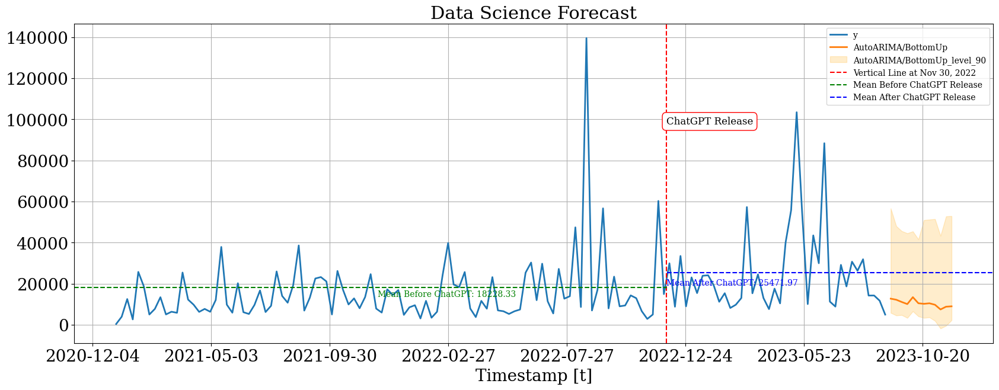

In [55]:
plot_forecast(plot_best_df, 'Data Science', 'AutoARIMA/BottomUp')

### Cluster Level

At the cluster level, most, if not all clusters, have shown an increase in their mean engagement after the release of ChatGPT, except for Government and Organizations Forecast. Let's break down the analysis for each cluster:

**`Business and Technology`**
- The business and technology landscape has witnessed a modest increase in mean engagement concerning topics related to data science, AI, and machine learning after the release of ChatGPT. This can be attributed to the fact that there was already a high level of engagement in data science within the business and technology sector, as many companies had already established dedicated data science departments. Consequently, we observed significant spikes immediately after the release of ChatGPT, as these individuals were already involved in data science prior to its release.

- The trend for the next quarter appears somewhat stagnant, but there is a substantial potential for growth, as indicated by the bootstrapped errors. With the right breakthrough or innovation, we could see a notable increase in data science activities.

**`Education and Learning`**
- In the field of education and learning, there has been a noticeable increase in data science activities following the release of ChatGPT. This trend is evident not only within our institution but also in our cohort, where most, if not all, students—especially those pursuing an MSDS—have started using ChatGPT as a tool to enhance their learning and support their academic endeavors. Initially, there was a lag in terms of engagement, but after a few months, data science in education and learning has become significantly more active, especially with the advancements in the large language model sector.

- However, in the next quarter, we might anticipate a decline in data science activities within the education sector due to the anticipated return to in-person learning and reduced reliance on virtual tools like ChatGPT for educational purposes. This shift is driven by the improving pandemic situation, which is enabling more traditional forms of teaching and learning.

**`Government and Organizations`**
- Visually, it may appear that the mean engagement decreased after the release of ChatGPT. However, in time series analysis, relying on visual inspection alone is not sufficient. After conducting the Wilcoxon Signed-Rank Test, a non-parametric statistical test, the results indicate that there is no significant difference in means before and after the release of ChatGPT in the government cluster. This suggests that the release of ChatGPT did not have a significant impact on the government sector.

- While the trend for the next quarter seems to be showing a slight decline, it's important to note that there is a high potential for improvement based on the bootstrapped errors.

- Notably, as more government agencies actively seek data scientists, such as the Banko Sentral ng Pilipinas, which is currently hiring data science professionals with a minimum of a master's degree, it becomes our responsibility as AIM graduates to further strengthen and expand data science activities within the government sector.

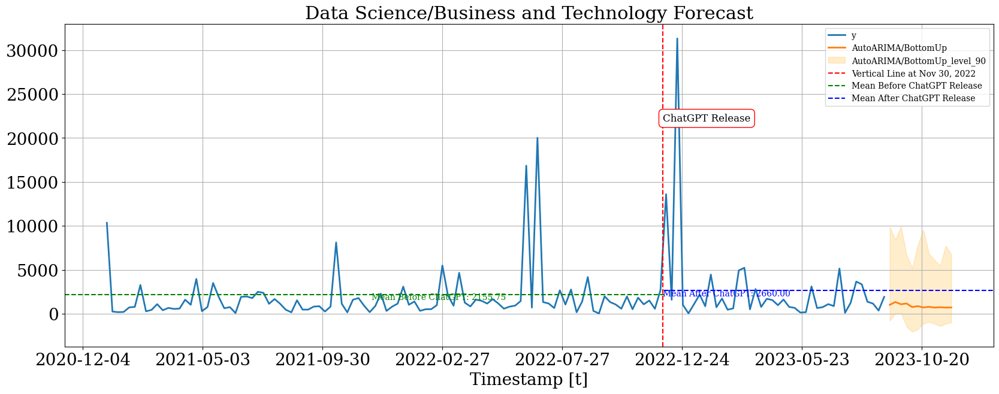

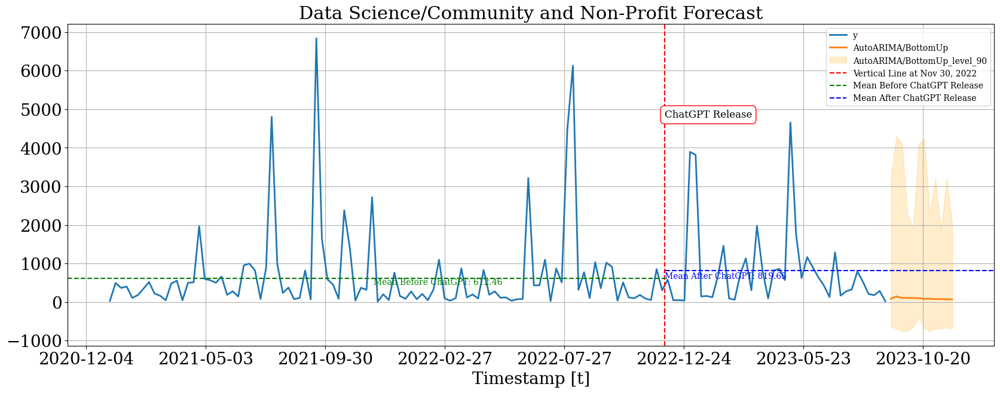

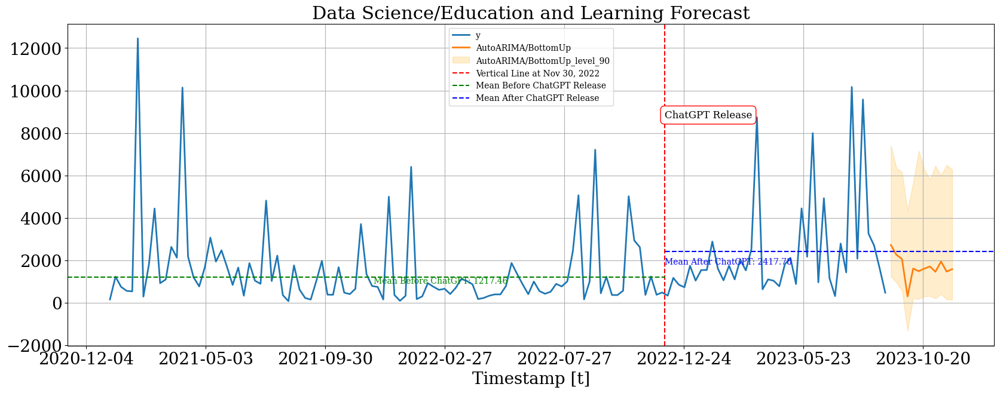

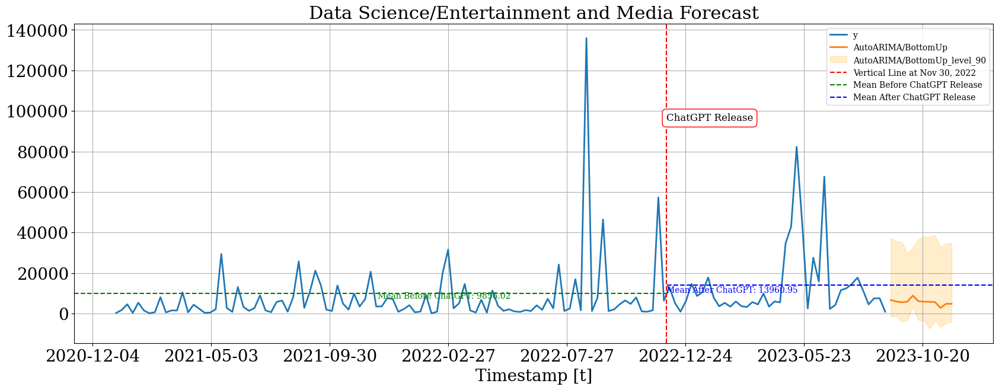

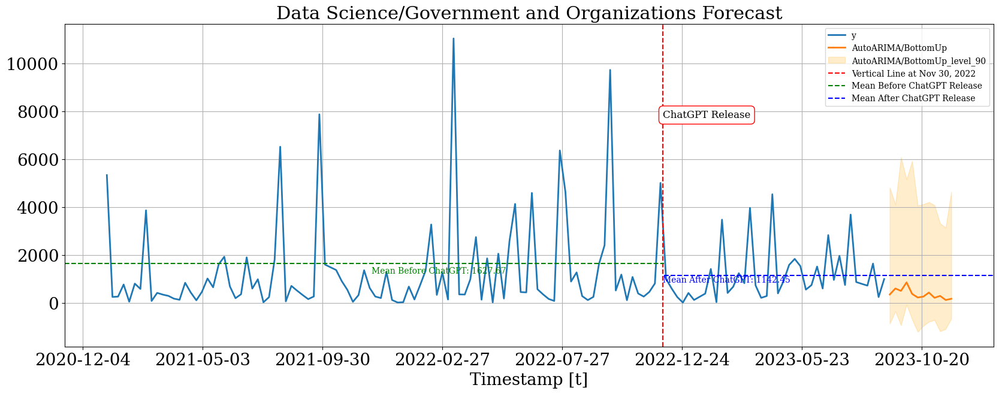

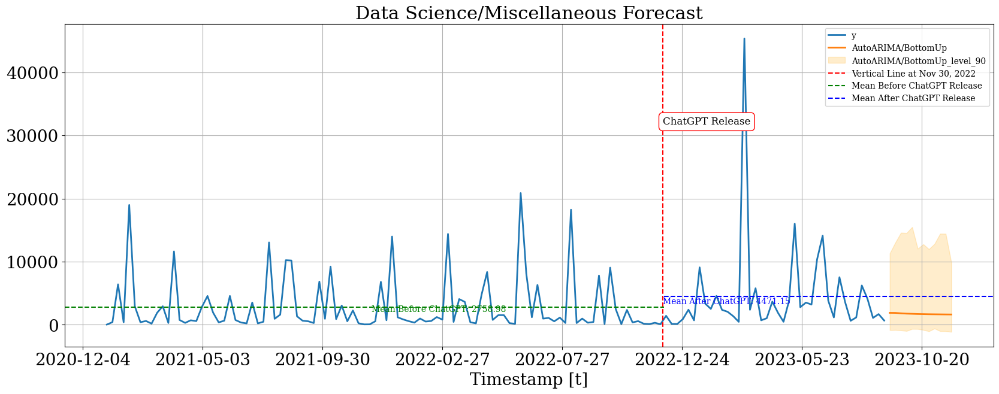

In [56]:
for cluster_ in tags['Topic/Cluster']:
    
    plot_forecast(plot_best_df, cluster_, 'AutoARIMA/BottomUp')

In [59]:
plot_best_df_gov = plot_best_df.loc[plot_best_df.index == 'Data Science/Government and Organizations']

# Calculate mean values before and after the ChatGPT release date
before_release_gov =  plot_best_df_gov.loc[(plot_best_df_gov['ds'] < vertical_line_date) & (plot_best_df_gov['ds'] >= '2022-01-01')]['y']
after_release_gov = plot_best_df_gov.loc[(plot_best_df_gov['ds'] >= vertical_line_date)]['y']

# Assuming you have two pandas Series: before_release_gov and after_release_gov
before_release_gov = before_release_gov.to_numpy()
after_release_gov = after_release_gov.to_numpy()

# Perform Wilcoxon signed-rank test with continuity correction
statistic, p_value = stats.wilcoxon(before_release_gov[:-8], after_release_gov[:-12], correction=True)

# Define null and alternative hypotheses
null_hypothesis = "There is no significant difference in means before and after the release of ChatGPT in the government cluster."
alternative_hypothesis = "There is a significant difference in means before and after the release of ChatGPT in the government cluster."

# Print the results
print("Wilcoxon Signed-Rank Test Results:")
print(f"Statistic: {statistic}")
print(f"P-Value: {p_value}")
print("")

# Check the significance level (e.g., alpha = 0.05)
alpha = 0.05

if p_value < alpha:
    print("Reject the null hypothesis.")
    print(alternative_hypothesis)
else:
    print("Fail to reject the null hypothesis.")
    print(null_hypothesis)

Wilcoxon Signed-Rank Test Results:
Statistic: 354.0
P-Value: 0.45981367328386114

Fail to reject the null hypothesis.
There is no significant difference in means before and after the release of ChatGPT in the government cluster.


### Category Level

At the category level, we can see how each category contributes to the cluster engagement in their community. Let's look at some notable categories within each cluster:

**`Business and Technology/PRODUCT_SERVICE`**
- This category has the highest contribution in engagement within the Business and Technology cluster showing very little engagement before the release of ChatGPT and a sudden jump in data science mentions shortly after the release of ChatGPT. It could be that in the wake of ChatGPT's release, data science became a buzzword in the tech industry. Companies often leverage trending topics in their marketing and branding efforts to stay relevant and capture the attention of potential customers.

- After the sudden jump in data science mentions, the engagement seems to have died down and it appears that it will continue to be the case for the next quarter.

**`Education and Learning/EDUCATION_COMPANY`**
- This category has the highest contribution to engagement within the Educations and Learning cluster and we can observe high magnitude fluctuations in the data science mentions after the release of ChatGPT. Education companies can be considered to be one of the more business and profit oriented categories within the Education and Learning cluster. We could say that marketing campaigns or promotions related to data science courses or programs could be the reason for the high magnitude fluctuations.

- So far, these high magnitude fluctuations have been consistent since the release of ChatGPT and we expect to see this flucuation to continue in the next quarter with a focus on data science education, admissions, and resources. 

**`Entertainment and Media/PERSONAL_BLOGS`**
- This category shows delayed engagement spikes could be potentially due to the delayed familiarization of bloggers with the applications of data science to different fields. Topics in these mentions span politics to AI's impact on the film industry, which reflects the evolving interest in technology developments.

- The next quarter may see a decrease in engagement from bloggers potentially due to content fatigue which may cause bloggers to change their content.

**`Government and Organizations/COVERNMENT_ORGANIZATIONS`** and **`Government and Organizations/NGO`**
- Similar to our observation in the cluster level, these categories appear to have the largest contribution to the decrease in data science mentions within the Government and Organizations cluster, but our observations in these categories support the conclusion that the release of ChatGPT did not have a significant impact on the data science mentions in this sector.

- The trend for the next quarter shows a slight decline for government organizations, while NGO shows a continuous stagnant trend in the next quarter. Despite this, we note that there is a high potential for improvement based on the bootstrapped errors especially for government organizations.


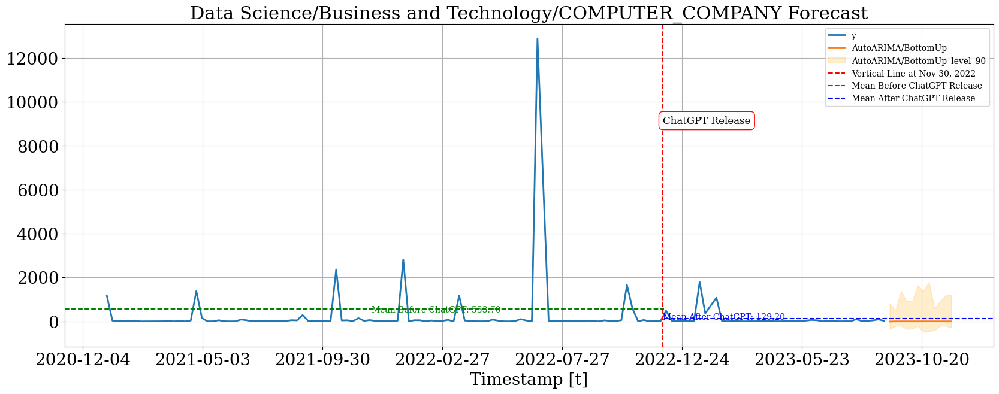

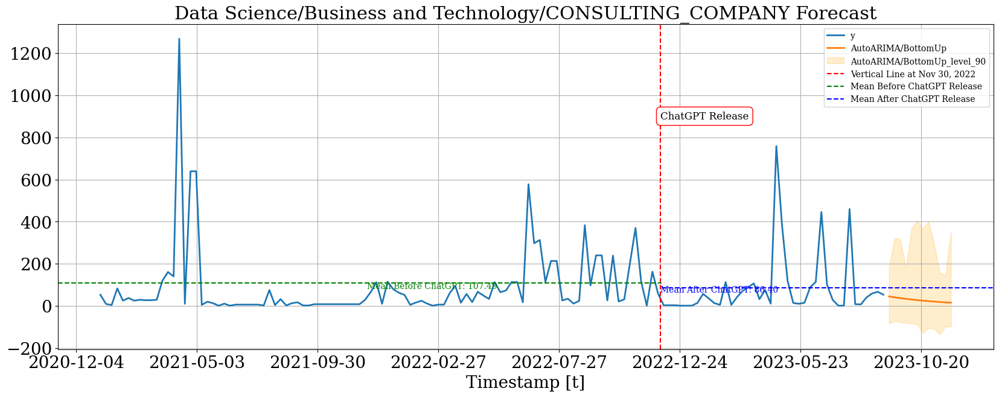

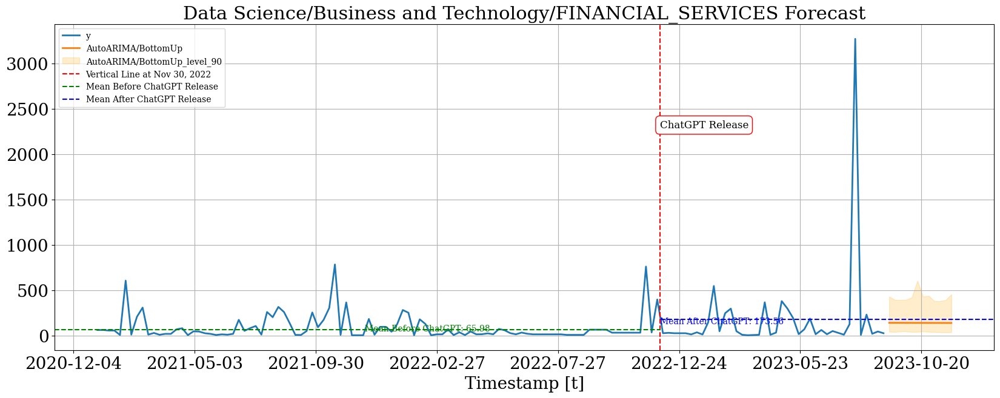

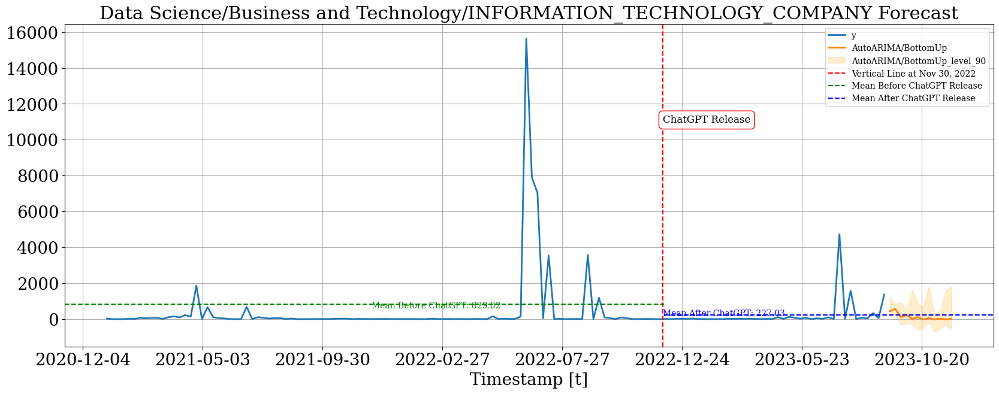

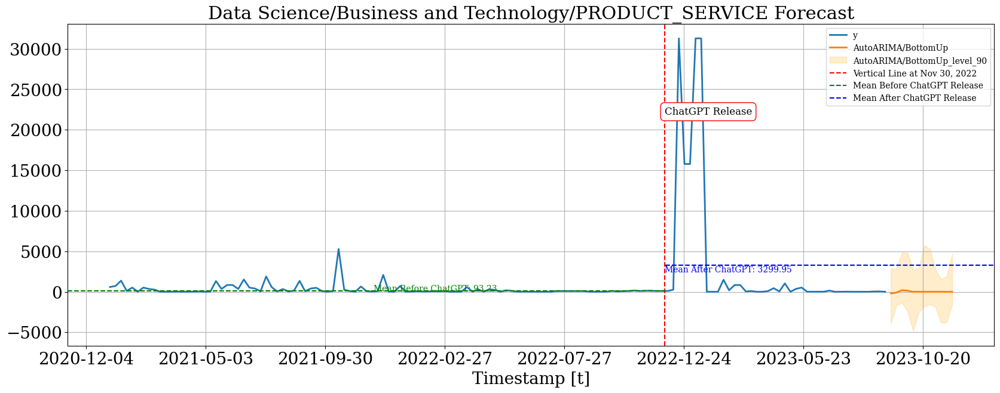

...

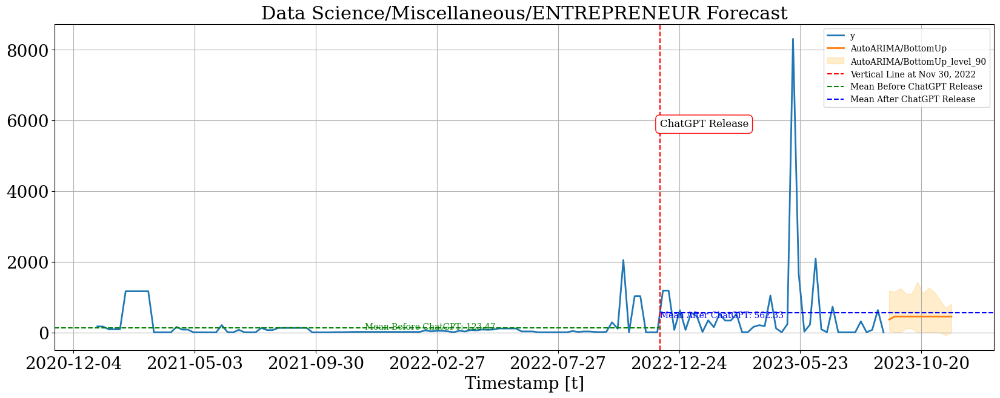

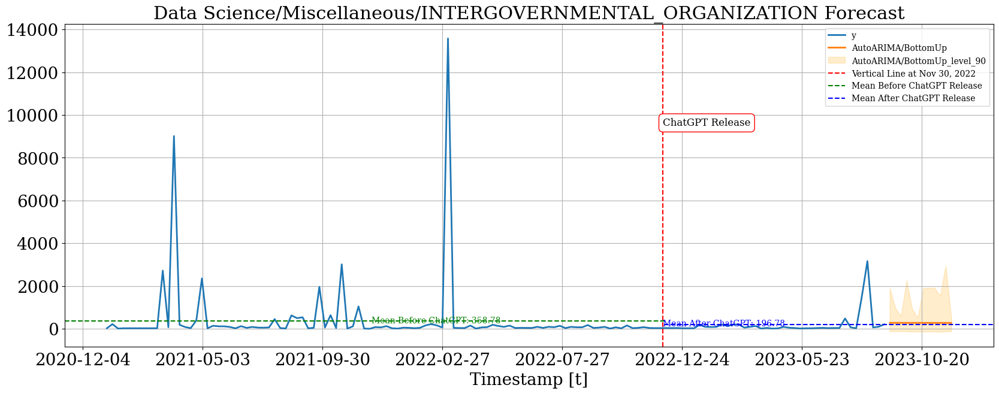

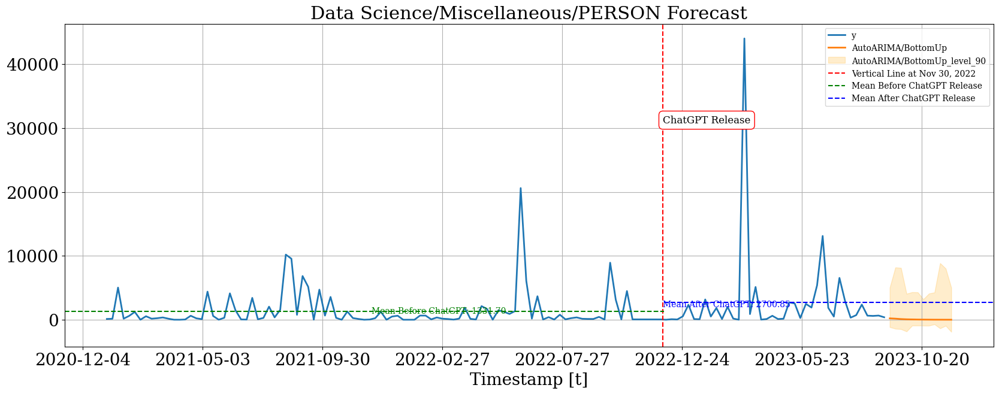

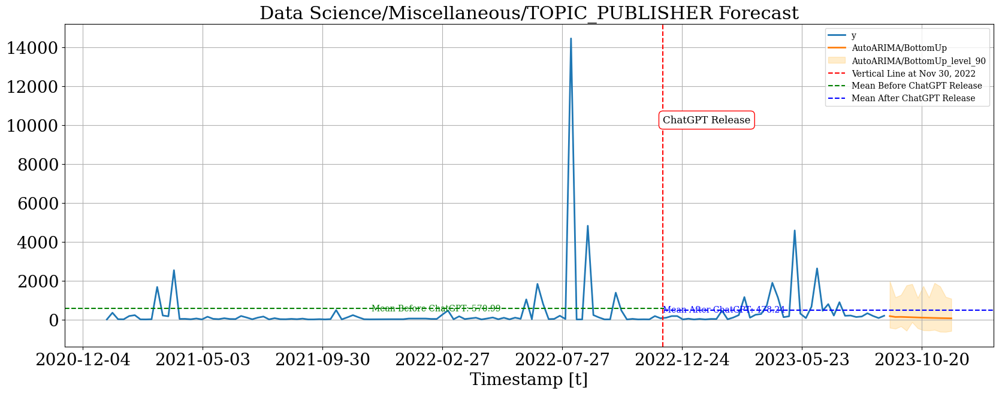

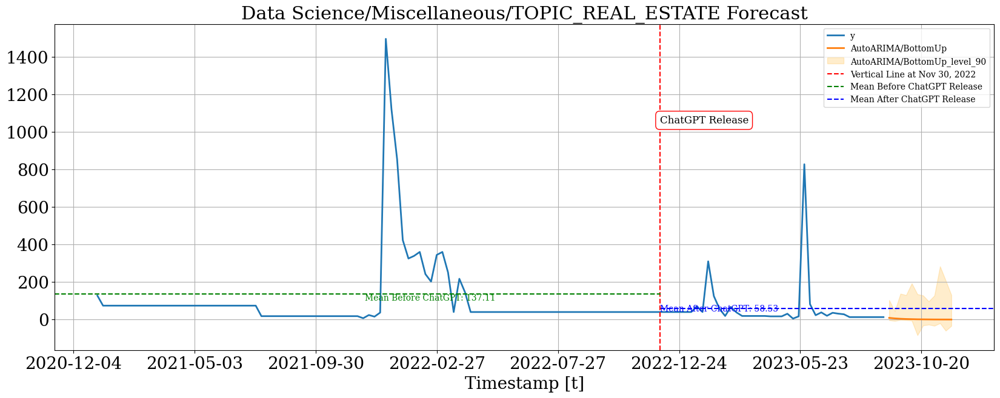

In [60]:
for category_ in tags['Topic/Cluster/Category']:
    
    plot_forecast(plot_best_df, category_, 'AutoARIMA/BottomUp')

# Conclusion

Through this project, we explored the evolving landscape of data science interest and engagement within different levels in our hierarchy, with a particular focus on the changes following ChatGPT's release. Our investigation involved through experimentation using various statistical and machine learning models. Among these models, the `AutoARIMA` model with `Bottom-Up` reconciliation has the best category-level forecasting performance for our dataset. Using `AutoARIMA` as our best model with `Bottom-Up` reconciliation as our best strategy in our hierarchical forecasting framework, we gained a nuanced understanding of engagement levels across different communities. The forecasts we generated revealed compelling narratives.

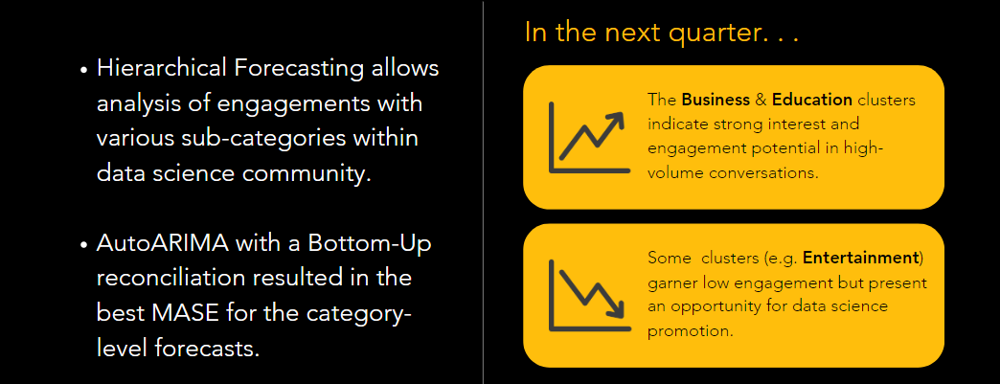

Our findings show an increase in interest and engagement potential in high-volume conversations within the Business and Education communities, hinting at substantial potential for nurturing data science initiatives and the cultivation of organic growth. On the other hand, we identified communities like the Entertainment community presenting a unique opportunity for promotion, given its comparatively lower engagement levels.

Our project transcends mere analysis. It empowers us to provide actionable insights, thereby bridging the gap between the increasing significance of data science and its untapped potential in the Philippines. Through this endeavor, we aim to contribute to the elevation of data science, leveraging its transformative power for promotion in a broader societal landscape.

# Recommendations

Following the insights presented in this project, we have several recommendations for the improvement of this study, its implications for businesses, and the guidance it offers to data scientists:

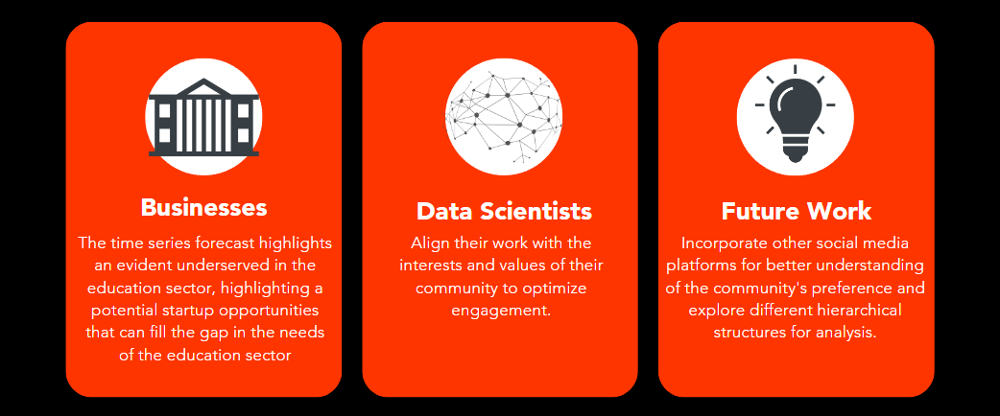

1. To enhance the robustness of this study, we can broaden our scope by including additional social media platforms and exploring different hierarchical structures. This expansion allows for a more comprehensive understanding of community engagement and offer fresh perspectives on hierarchical structures for analysis.
2. Beyond mere mentions, we can explore the sentiment of these messages. This approach will provide a more nuanced perspective, allowing us to gain clearer insights into how various communities perceive data science.
3. In terms of business implications, our forecasts reveal potential startup opportunities that can address the unmet needs within the education sector. This insight could be leveraged to identify and capitalize on gaps in needs of the education sector.
4. From a data scientist's standpoint, our forecasts empower us to align our work with the values and interests of our target communities. By doing so, we can optimize engagement levels and ensure that our efforts resonate effectively within these diverse contexts.

These recommendations not only enrich our understanding of this study but also provide valuable insights for businesses seeking growth opportunities and data scientists striving to make a meaningful impact within their target communities.

# References

**Data Science**

[1] International Labour Organization & Australian Aid. (2020). The Future of Work in the Philippines: Assessing the impact of technological changes on occupations and sectors. Retrieved from https://www.ilo.org/wcmsp5/groups/public/---asia/---ro-bangkok/---ilo-manila/documents/publication/wcms_762207.pdf

[2] Parmezan, Antonio & Alves de Souza, Vinícius & Batista, Gustavo. (2019). Evaluation of statistical and machine learning models for time series prediction: Identifying the state-of-the-art and the best conditions for the use of each model. Information Sciences. 10.1016/j.ins.2019.01.076. Retrieved from https://www.researchgate.net/publication/330742498_Evaluation_of_statistical_and_machine_learning_models_for_time_series_prediction_Identifying_the_state-of-the-art_and_the_best_conditions_for_the_use_of_each_model

**Time-Series Analysys**

[3] Olivares, K., Garza, F., Luo, D., et. al. (July 2022). HierarchicalForecast: A Reference Framework for Hierarchical Forecasting in Python. Retrieved from https://arxiv.org/abs/2207.03517

[4] Hyndman, R.J., & Athanasopoulos, G. (2021). “Forecasting: principles and practice, 3rd edition: Chapter 11: Forecasting hierarchical and grouped series.”. OTexts: Melbourne, Australia. OTexts.com/fpp3 Accessed on July 2022. Retrieved from https://otexts.com/fpp3/hierarchical.html

[5] Orcutt, G.H., Watts, H.W., & Edwards, J.B.(1968). Data aggregation and information loss. The American Economic Review, 58 , 773{787). Retrieved from https://www.jstor.org/stable/1815532

[6] Munim, Ziaul. (2022). State-space TBATS model for container freight rate forecasting with improved accuracy. Maritime Transport Research. 3. 100057. 10.1016/j.martra.2022.100057. Retrieved from https://www.researchgate.net/publication/359200514_State-space_TBATS_model_for_container_freight_rate_forecasting_with_improved_accuracy

[7] Orcutt, G.H., Watts, H.W., & Edwards, J.B.(1968). “Data aggregation and information loss”. The American Economic Review, 58 , 773{787). Retrieved from https://www.jstor.org/stable/1815532

[8] Wickramasuriya, S. L., Athanasopoulos, G., & Hyndman, R. J. (2019). “Optimal forecast reconciliation for hierarchical and grouped time series through trace minimization”. Journal of the American Statistical Association, 114 , 804–819. doi:10.1080/01621459.2018.1448825.. - Wickramasuriya, S.L., Turlach, B.A. & Hyndman, R.J. (2020). “Optimal non-negative forecast reconciliation”. Stat Comput 30, 1167–1182, https://doi.org/10.1007/s11222-020-09930-0.

[9] Rob J. Hyndman, Yeasmin Khandakar (2008). “Automatic Time Series Forecasting: The forecast package for R”. Retrieved from https://www.jstatsoft.org/article/view/v027i03

[10] Hyndman, Rob, et al (2008). “Forecasting with exponential smoothing: the state space approach”. Retrieved from https://robjhyndman.com/expsmooth/

[11] Puwasala Gamakumara Ph. D. dissertation. Monash University, Econometrics and Business Statistics (2020). “Probabilistic Forecast Reconciliation”. Retrieved from https://bridges.monash.edu/articles/thesis/Probabilistic_Forecast_Reconciliation_Theory_and_Applications/11869533

[12] Panagiotelis A., Gamakumara P. Athanasopoulos G., and Hyndman R. J. (2022). “Probabilistic forecast reconciliation: Properties, evaluation and score optimisation”. European Journal of Operational Research. Retrieved from https://www.sciencedirect.com/science/article/abs/pii/S0377221722006087

[13] Makridakis, Spyros & Hibon, Michele. (2000). The M3-Competition: Results, Conclusions and Implications. International Journal of Forecasting. 16. 451-476. 10.1016/S0169-2070(00)00057-1. 

[14] Hyndman, R., Koehler, A. (November 2005). Another look at measures of forecast accuracy. Retrieved from https://www.robjhyndman.com/papers/mase.pdf